<a href="https://colab.research.google.com/github/DanielaRodriguezMendez/Proyecto-de-Abel/blob/main/Rostros_Daniela_y_Sharon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instituto Tecnológico de Costa Rica | TEC
# Carrera de Ingeniería en Computación 
# I Semestre de 2023
# Proyecto Programado (Fase I – Entrevistador asistido por IA) 
# Dr. Abel Méndez Porras
# amendez@itcr.ac.cr
# Porcentaje: 20%

# Entrevistador asistido por IA



El reconocimiento facial y la detección de emociones son tecnologías que se han vuelto cada vez más populares en los últimos años. Estas tecnologías utilizan algoritmos de inteligencia artificial para analizar imágenes y detectar patrones faciales que permiten identificar a las personas y sus emociones.
En cuanto a las oportunidades, el reconocimiento facial puede tener aplicaciones en la seguridad, el marketing y la atención al cliente. Por ejemplo, en la seguridad se pueden utilizar sistemas de reconocimiento facial para identificar a personas en lugares públicos o para controlar el acceso a edificios y sistemas de seguridad. En el marketing, se pueden utilizar para personalizar la publicidad en función de la edad, el género y otros datos demográficos. Y en la atención al cliente, se pueden utilizar para detectar la satisfacción del cliente en tiempo real y responder adecuadamente.

En esta primera etapa del proyecto del curso de Taller de Programación estaremos utilizando los resultados de consultas a modelos de Deep Learning para aplicar los conocimientos adquiridos en clase. 

## Objetivo
Desarrollar una aplicación de complejidad baja que permita poner en práctica los conocimientos adquiridos en los cursos de Introducción a la Programación y Taller de Programación.
## Objetivos Específicos
*   Identificar los requerimientos para resolver un problema específico desde la perspectiva de resolución de problemas, técnicas con listas y diccionarios.
*   Diseñar una aplicación para un problema específico desde la perspectiva de resolución de problemas, técnicas con listas y diccionarios.
*.  Desarrollar una aplicación para un problema específico desde la perspectiva de resolución de problemas, técnicas con listas y diccionarios.

## Configuración previa 

### Cargar Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Leer cámara
Tomado de https://colab.research.google.com/drive/1QnC7lV7oVFk5OZCm75fqbLAfD9qBy9bw?usp=sharing#scrollTo=ilLkpcKanPRb



### Importar dependencies

In [ ]:
# import dependencies
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time

### Convertir el objeto JavaScript un objeto OpenCV image

In [ ]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

### Crear nuestro live video stream

In [ ]:
# JavaScript to properly create our live video stream using our webcam as input
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;
    
    var pendingResolve = null;
    var shutdown = false;
    
    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }
    
    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }
    
    async function createDom() {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);
      
      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);
           
      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);
      
      const instruction = document.createElement('div');
      instruction.innerHTML = 
          '<span style="color: red; font-weight: bold;">' +
          'When finished, click here or on the video to stop this demo</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };
      
      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = 640; //video.videoWidth;
      captureCanvas.height = 480; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);
      
      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();
      
      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }
            
      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }
      
      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;
      
      return {'create': preShow - preCreate, 
              'show': preCapture - preShow, 
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)
  
def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

### Iniciar streaming video

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont

In [ ]:
import cv2
import numpy as np
import tensorflow as tf
from keras.models import model_from_json

### Cargar modelos de Deep Learning entrenados

*   Para detectar los rostros se utiliza el modelo de Face Haar Cascade.
*   Para detectar las emociones se utiliza el modelo de VGG.
*   También se utiliza un algoritmo adicional para pasar la información del algortimo de VGG a un formato JSON.

Estos modelos y algoritmos están disponibles en el siguiente enlace [Descargar modelos y algoritmos](https://drive.google.com/drive/folders/1KctA_s25bqqMOUlQuy0lwTm0HkBGVycF?usp=sharing). Usted los debe colocar en su Google Drive y modificar la ruta de acceso. 



In [ ]:
#Cargar modelos de Deep Learning entrenados
face_haar_cascade = cv2.CascadeClassifier('/content/drive/MyDrive/images/haarcascade_frontalface_alt.xml') 
model = model_from_json(open("/content/drive/MyDrive/images/model.json", "r").read()) 
model.load_weights('/content/drive/MyDrive/images/model.h5') 


Crear interfaz
https://www.youtube.com/watch?v=oIVmV41uyK8

#Entrevista personal

## Recolectar información personal


Información requerida al entrevistar una persona (Toda esta información debe ser almacenada en un diccionario. Cada diccionario de cada entrevista debe ser colocado en una lista. Se maneja una lista principal donde se tiene todas las entrevistas de las personas).
*   Identificación  
*   Nombre 
*   Fecha de nacimiento
*   Nacionalidad
*   Números de teléfono y celular (un diccionario)
*   Emails (una lista con uno o varios emails)
*   Dirección
*   Estado civil
*   Cantidad de hijos indicando el género, la fecha de nacimiento(un diccionario) 
*   Entrevistas (cada persona puede ser entrevistada cero o más veces). Las entrevistas se realizan en tiempo real utilizando una camára integrada a la computadora o externa (el profesor facilita el código para activar la camára, capturar el video y capturar los frames cada cierto tiempo). Se debe crear una lista con sublistas donde cada sublista tiene las imagenes capturas y las emociones reportadas durante la entrevista. Además, debe guardar coordenadas donde se encuentra el rostro en la imagen. Para cada entrevista, el entrevistado debe contar historias cortas sobre los siguientes 4 tópicos:


  >*   Una experiencia de sorpresa o asombro que ha tenido que vivir.
  >*   Una experiencia de tristeza que ha tenido que vivir.
  >*   Una experiencia de enojo o frustración que ha tenido que vivir.
  >*   Una experiencia de felicidad que ha tenido que vivir.




## Recolectar información emociones
Este código se encarga de ejecutar la captura de video de la cámara, detectar los rostros en las imágenes y reconocer las emociones presentes en los rostros. Cuando se hace la entrevista es en este código donde usted de obtener la información para crear las listas con la información solicitada.

In [ ]:
def show_image(image_path):
  """ This function shows an image.
    Arguments:
        image_path {str} -- Image path. 
  """
  img = cv2.imread(image_path)
  img_cvt=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  plt.imshow(img_cvt)
  plt.show()
#Code taken from ordenamientos de "Reconocimiento de Personas" in week 8 of Introducción a la Programación.

In [ ]:
Interviews = []
j = 5

<IPython.core.display.Javascript object>

Ubicación del rostro: [[257 209 210 210]]
1/1 [==============================] - 0s 39ms/step
Predicciones:  [[2.3908534e-03 2.9288429e-05 1.2879692e-03 8.4792709e-01 4.3967040e-03
  1.3342951e-03 1.4263377e-01]]
3 [2.3908534e-03 2.9288429e-05 1.2879692e-03 8.4792709e-01 4.3967040e-03
 1.3342951e-03 1.4263377e-01]
Predicciones:  {'angry': 0.0023908534, 'disgust': 2.9288429e-05, 'fear': 0.0012879692, 'happiness': 0.8479271, 'sadness': 0.004396704, 'surprise': 0.0013342951, 'neutral': 0.14263377}
happyness


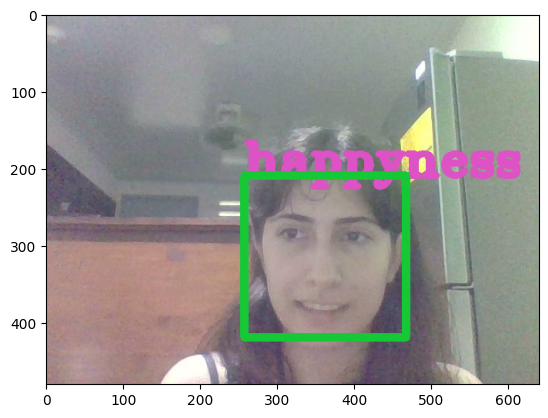

Ubicación del rostro: [[260 207 214 214]]
1/1 [==============================] - 0s 61ms/step
Predicciones:  [[2.3597004e-03 3.2515112e-05 1.6842739e-03 9.0621316e-01 4.4291141e-03
  1.7105339e-03 8.3570734e-02]]
3 [2.3597004e-03 3.2515112e-05 1.6842739e-03 9.0621316e-01 4.4291141e-03
 1.7105339e-03 8.3570734e-02]
Predicciones:  {'angry': 0.0023597004, 'disgust': 3.2515112e-05, 'fear': 0.001684274, 'happiness': 0.90621316, 'sadness': 0.004429114, 'surprise': 0.0017105339, 'neutral': 0.08357073}
happyness


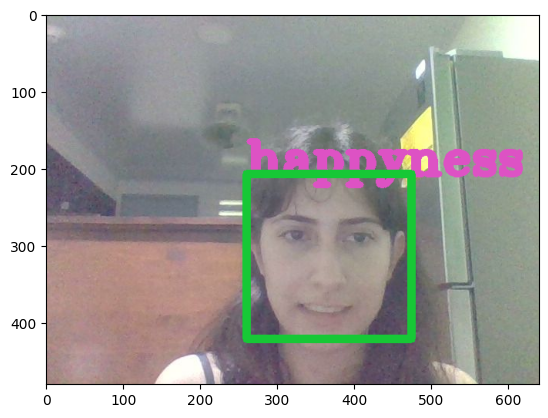

Ubicación del rostro: [[291 218 208 208]]
1/1 [==============================] - 0s 39ms/step
Predicciones:  [[8.9943381e-03 1.7396099e-04 4.4584628e-03 6.5414554e-01 1.7170830e-02
  2.5093530e-03 3.1254753e-01]]
3 [8.9943381e-03 1.7396099e-04 4.4584628e-03 6.5414554e-01 1.7170830e-02
 2.5093530e-03 3.1254753e-01]
Predicciones:  {'angry': 0.008994338, 'disgust': 0.00017396099, 'fear': 0.004458463, 'happiness': 0.65414554, 'sadness': 0.01717083, 'surprise': 0.002509353, 'neutral': 0.31254753}
happyness


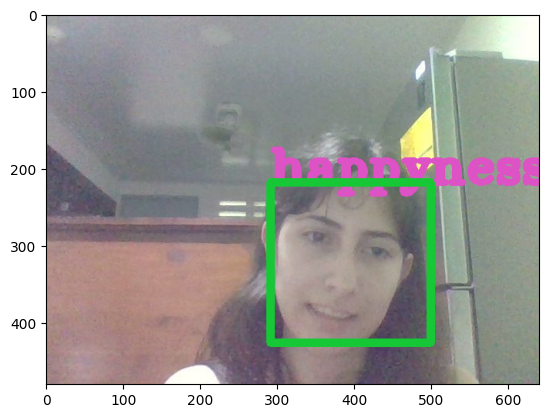

Ubicación del rostro: [[261 207 217 217]]
1/1 [==============================] - 0s 40ms/step
Predicciones:  [[2.5828255e-03 3.5675464e-05 1.9907944e-03 8.5737687e-01 5.3822594e-03
  2.2128662e-03 1.3041864e-01]]
3 [2.5828255e-03 3.5675464e-05 1.9907944e-03 8.5737687e-01 5.3822594e-03
 2.2128662e-03 1.3041864e-01]
Predicciones:  {'angry': 0.0025828255, 'disgust': 3.5675464e-05, 'fear': 0.0019907944, 'happiness': 0.8573769, 'sadness': 0.0053822594, 'surprise': 0.0022128662, 'neutral': 0.13041864}
happyness


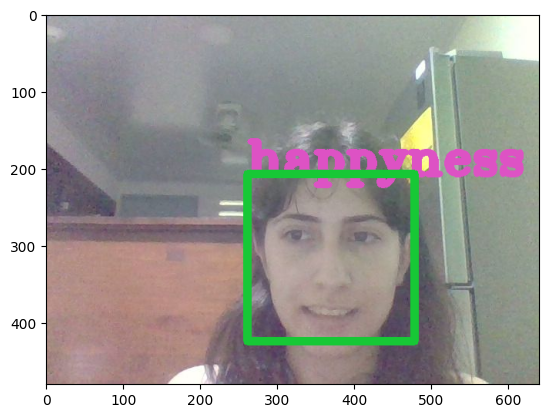

Ubicación del rostro: [[276 216 204 204]]
1/1 [==============================] - 0s 37ms/step
Predicciones:  [[2.6948925e-03 4.3174914e-05 2.3507725e-03 8.3702117e-01 7.7096024e-03
  2.0897449e-03 1.4809074e-01]]
3 [2.6948925e-03 4.3174914e-05 2.3507725e-03 8.3702117e-01 7.7096024e-03
 2.0897449e-03 1.4809074e-01]
Predicciones:  {'angry': 0.0026948925, 'disgust': 4.3174914e-05, 'fear': 0.0023507725, 'happiness': 0.8370212, 'sadness': 0.0077096024, 'surprise': 0.002089745, 'neutral': 0.14809074}
happyness


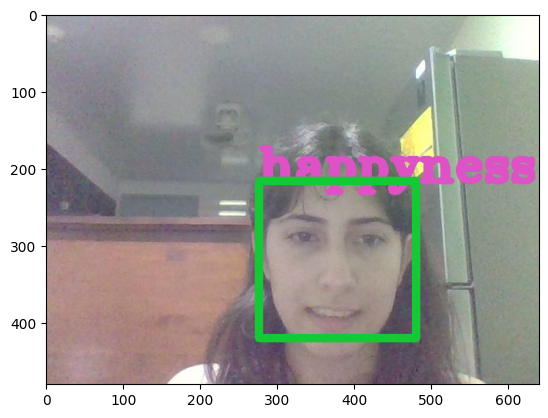

In [ ]:
from tensorflow.python.ops.math_ops import sign
# start streaming video from webcam
video_stream()
# label for video
label_html = 'Capturing...'
# initialze bounding box to empty
bbox = ''
count = 0 
listan= []
while True:
  js_reply = video_frame(label_html, bbox)
  if not js_reply:
    break

  # convert JS response to OpenCV Image
  img = js_to_image(js_reply["img"])
  img_copy = img


  # create transparent overlay for bounding box
  bbox_array = np.zeros([480,640,4], dtype=np.uint8)


  if count == j: #El tiempo para capturar el frame y procesarlo
    #Este sería el path de la imagen guardada
    image_path ='/content/drive/MyDrive/frames' + 'nombre' + str(j) +  '.jpg'
    #se guarda el fotograma con el "nombre" más el número del contador i
    cv2.imwrite(image_path , img)
    
    #Detectar los rostros usando Face Haar Cascade
    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #En faces_deteted se encuentran los rotros detectados
    faces_detected = face_haar_cascade.detectMultiScale(gray_image,1.32,5)
    #Imprimir ubicación de los rostros en la imagen
    print("Ubicación del rostro:", faces_detected)
    im2Display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    imTemp = im2Display.copy()
    listan.append(image_path)
    listan.append([faces_detected])


    #Hacer un rectángulo en cada rostro detectado en la imagen
    for (x,y,w,h) in faces_detected:
        cv2.rectangle(img,(x,y), (x+w,y+h), (255,0,0), thickness=7)

        roi_gray=gray_image[y:y+w,x:x+h]
        roi_gray=cv2.resize(roi_gray,(48,48))

        #Processes the image and adjust it to pass it to the model
        image_pixels = tf.keras.preprocessing.image.img_to_array(roi_gray)
       
        image_pixels = np.expand_dims(image_pixels, axis = 0)
        image_pixels /= 255

        #Obtener las emociones para cada rostro detectado en la imagen
        #Get the prediction of the model
        predictions = model.predict(image_pixels)
        #Mostrar todas las emociones detectadas
        print("Predicciones: ", predictions)
        #Mostrar la emoción más significativa (con el valor más alto)
        max_index = np.argmax(predictions[0])
        print(max_index, predictions[0])
        #El orden en que vienen las emociones
        emotion_detection = ('angry', 'disgust', 'fear', 'happyness', 'sadness', 'surprise', 'neutral')

        emotion_prediction1 = emotion_detection[max_index]
        #Crear un diccionario para almacenar la emoción y el valor para la emoción
        frame_dic = dict(
            angry = predictions[0][0],
            disgust = predictions[0][1],
            fear = predictions[0][2],            
            happiness = predictions[0][3],
            sadness = predictions[0][4],
            surprise = predictions[0][5],
            neutral = predictions[0][6]) 
        print("Predicciones: ", frame_dic)
        listan.append(frame_dic)
        print( emotion_prediction1 )
        
        #Mostrar en la imagen un texto de la emoción más significativa
        ubicacion = (x,y)
        font = cv2.FONT_HERSHEY_TRIPLEX
        tamañoLetra = 2
        colorLetra = (221,82,196)
        grosorLetra = 7
        #Escribir texto con la emoción más significativa
        cv2.putText(imTemp, emotion_prediction1, ubicacion, font, tamañoLetra, colorLetra, grosorLetra)
        pt1 = (x, y)
        pt2 = (x+w, y+h)
        color = (23,200,54)
        thickness = 10
        cv2.rectangle(imTemp, pt1, pt2, color, thickness)

    #Mostrar la imagen con los cuadros en los rostros y el texto de la emoción más significativa
    plt.imshow(imTemp)
    plt.show()

    j +=5
  count +=1

In [ ]:

def interviewdata():
  """Returns the person's diccionary with all the information. 

  Returns:
       interview {list} -- A list with people's diccionaries.
  """
  # Inputs of the values requested.
  ID = int(input("Place your identification: "))
  name = input("Place your name: ", )
  birth_date = input("Place your birth date(year/month/day): ")
  telefone = int(input("Place your telefone number: "))
  gender = input("Place your gender(female or male): ")
  email = input("Place your email: ")
  address = input("Place your address: ")
  marital_status = input("Place your marital status: ")
  nationality = input("Place your nationality: ")
  number = int(input("Place how many children you have: "))
  c = 0
  children = {}
  children["number"] = number 
  children["info"] = []

  # Code to classify the children information in case there is more than one.
  while c < number:
   u = input("Place your child's gender(female or male): ")
   a = input("Place your child's birth date: ")
   ll = []
   ll.append(u) 
   ll.append(a)
   children["info"].append(ll)
   c = c + 1

  # Add up the interviews data to a diccionary.
  interview = {}
  interview["ID"] = ID
  interview["name"] = name
  interview["gender"] = gender
  interview["birth date"] = birth_date
  interview["telefone"] = telefone
  interview["email"] = email
  interview["address"] = address
  interview["marital status"] = marital_status
  interview["nationality"] = nationality
  interview["children"] = children
  
  

  # Code to classify the information of the images in sub lists of 3 values inside a list.
  ll = []
  c = 0
  p = 3
  pp = []
  a = len(listan)
  while c < a:
   for x in listan:
    pp.append(x)
    p = p - 1
    a = a - 1
    if p == 0:
      ll.append(pp)
      pp = []
      p = 3


  interview["frames"] = ll
  return interview
b = interviewdata()
Interviews.append(b)
print(Interviews)





Place your identification: 209870987
Place your name: Alex
Place your birth date(year/month/day): 2003/12/02
Place your telefone number: 2939393
Place your gender(female or male): male
Place your email: dkdkdk
Place your address: ddkdk
Place your marital status: Single
Place your nationality: dd
Place how many children you have: 1
Place your child's gender(female or male): male
Place your child's birth date: 09/04/0
[{'ID': 208500806, 'name': 'Sharon Blanco Piedra', 'gender': 'female', 'birth date': '2004/02/07', 'telefone': 84166154, 'email': 'sharoniris88@gmail.com', 'address': '300 mts Este del Aserradero', 'marital status': 'Single', 'nationality': 'Costa Rican', 'children': {'number': 2, 'info': [['female', '08/02/2003'], ['male', '09/03/2004']]}, 'frames': [['/content/drive/MyDrive/framesnombre5.jpg', [array([[283, 174, 235, 235]], dtype=int32)], {'angry': 0.06920064, 'disgust': 0.00043989267, 'fear': 0.100069515, 'happiness': 0.0064721704, 'sadness': 0.3447096, 'surprise': 0.001

# Consultas


1.   Mostrar la información de todas las personas entrevistas (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

2.   Mostrar la información de todas las personas entrevistas ordenada ascendentemente por edad. El método de ordenamiento a utilizar es el método por inserción (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

3.   Mostrar la información de todas las personas entrevistas ordenada descendente mente por la cantidad de hijos. El método de ordenamiento a utilizar es el método por de la bubuja (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

4. Mostrar la información de todas las personas entrevistas ordenada descendentemente por la cantidad de hijos. El método de ordenamiento a utilizar es el método por de la quicksort (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros. También, imprimir una lista con sublistas donde la primera sublista tiene la información de las personas que tienen únicamente hijos de género femenino, la segunda sublista tiene información de personas que tienen únicamente hijos de género masculino y la última sublista tiene información de personas que tienen hijos tanto de género femenino como másculino. 

5. Obtener para cada persona entrevistada las emociones sin ordenar y guardar en una lista (una lista por entrevista) con sublistas la siguiente información: en la primera sublista colocar la identificación, el nombre, el género y la edad de la persona entrevistada, en las siguientes sublistas colocar las emociones expresadas por la persona. Por ejemplo, si la persona apareció en 10 fotogramas entonces se deben crear 10 sublistas, cada sublista pertenece a las emociones emitidas por el candidato en un fotograma. 

6. Una vez creada esta listas (una por entrevista) con sublistas del punto anterior, se debe ordenar las sublistas de forma ascendente por la emoción felicidad (happiness) utilizando el técnica de ordenamiento Quicksort.

7. Para cada persona entrevistada muestre un gráfico para comparar las emociones reportadas durante la entrevista.

8. Incluya en el documento escrito la entrevista a dos personas. De aportar toda la información recolectada, las imágenes recolectadas en la entrevista con un cuadro en los rostros presentes. Además, debe mostrar la información de las emociones reportadas. Por último, incluya un análisis de la importancia de este tipo de algoritmos y de la importancia de la privacidad de la información en este tipo de sistemas.




#Consulta 1
Mostrar la información de todas las personas entrevistas (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.


ID :  208500806
name :  Sharon Blanco Piedra
gender :  female
birth date :  2004/02/07
telefone :  84166154
email :  sharoniris88@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
female 
08/02/2003 
male 
09/03/2004 


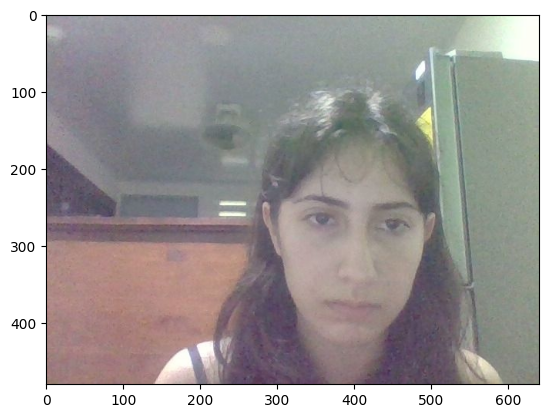

[array([[283, 174, 235, 235]], dtype=int32)]
angry 0.06920064
disgust 0.00043989267
fear 0.100069515
happiness 0.0064721704
sadness 0.3447096
surprise 0.0018441533
neutral 0.4772639


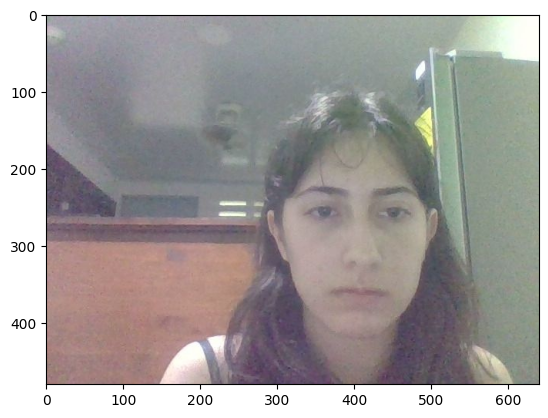

[array([[291, 166, 230, 230]], dtype=int32)]
angry 0.04641404
disgust 0.00018954767
fear 0.12724043
happiness 0.00086199417
sadness 0.5307853
surprise 0.0004992461
neutral 0.2940094


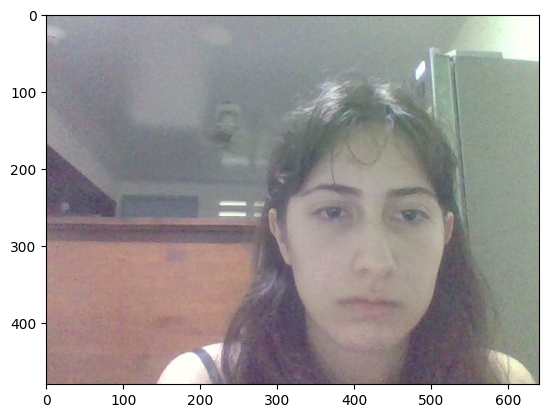

[array([[293, 157, 269, 269]], dtype=int32)]
angry 0.043305356
disgust 0.00015068507
fear 0.10444007
happiness 0.0010058512
sadness 0.50212294
surprise 0.000370827
neutral 0.34860438


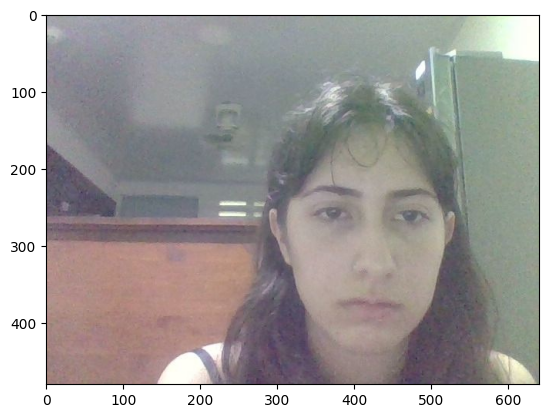

[array([[290, 159, 266, 266]], dtype=int32)]
angry 0.053196948
disgust 0.00020436705
fear 0.08568812
happiness 0.0017861807
sadness 0.44692162
surprise 0.00039068412
neutral 0.41181216


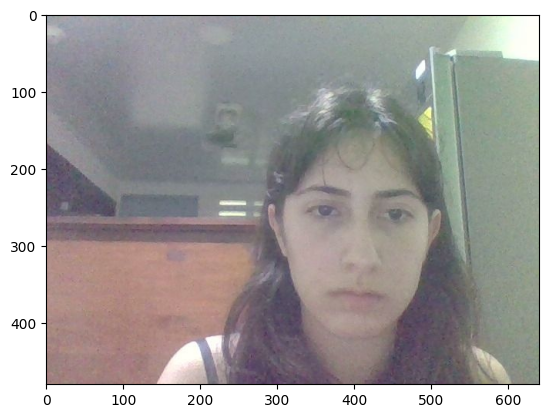

[array([[291, 167, 235, 235]], dtype=int32)]
angry 0.0694405
disgust 0.00035139945
fear 0.097089976
happiness 0.0026550014
sadness 0.39821315
surprise 0.00087876635
neutral 0.43137118

ID :  20484048484
name :  Dayana Núñez
gender :  male
birth date :  2000/12/01
telefone :  84847867
email :  numexs87@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
male 
9900 
male 
9439 


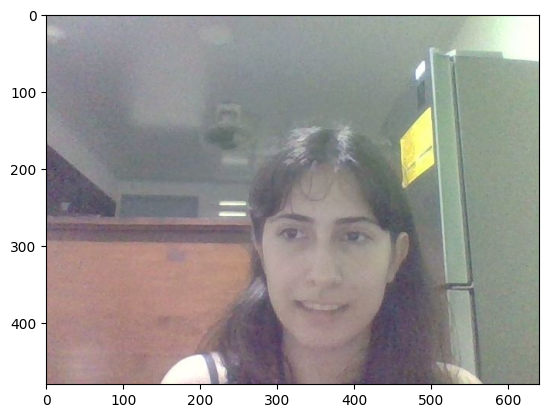

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


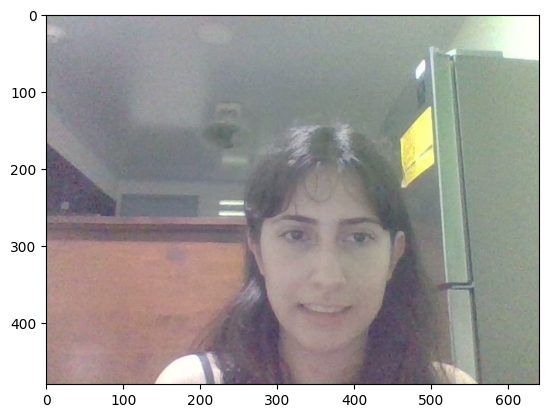

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


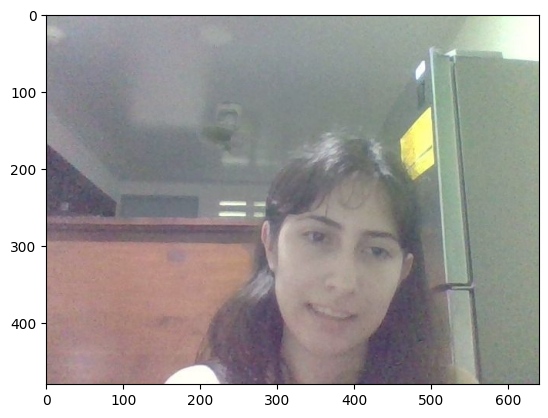

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


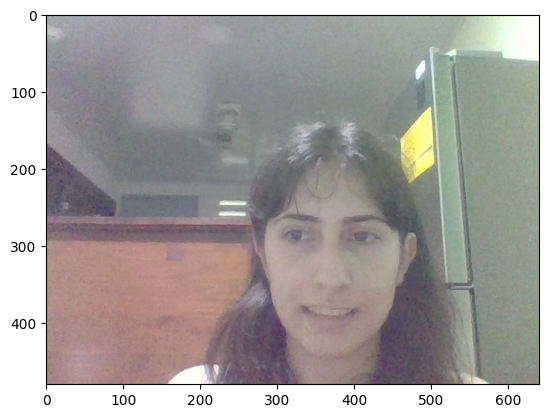

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


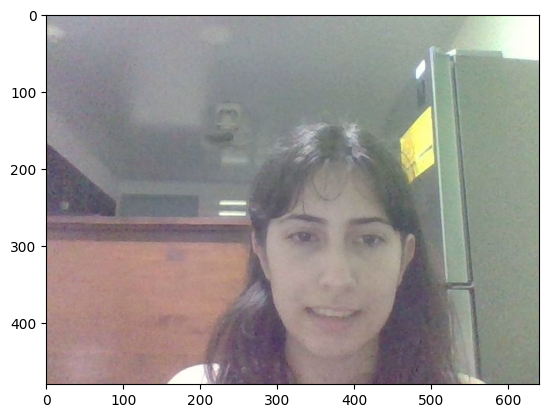

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074

ID :  209870987
name :  Alex
gender :  male
birth date :  2003/12/02
telefone :  2939393
email :  dkdkdk
address :  ddkdk
marital status :  Single
nationality :  dd
children :
number 1
info
male 
09/04/0 


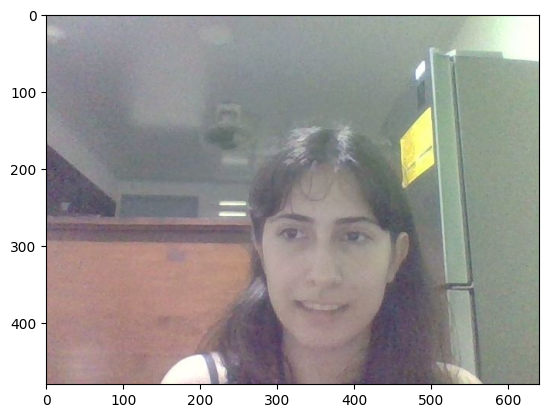

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


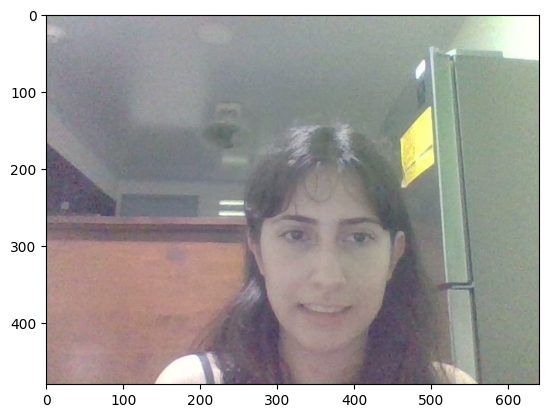

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


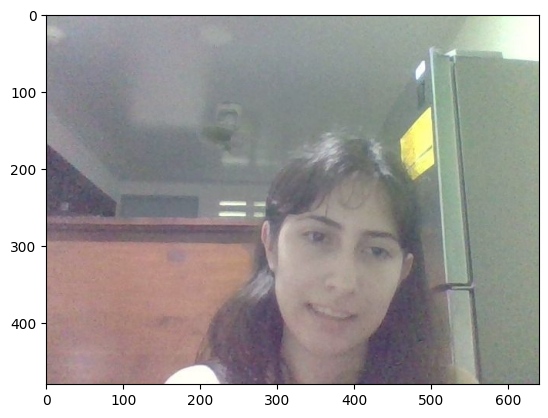

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


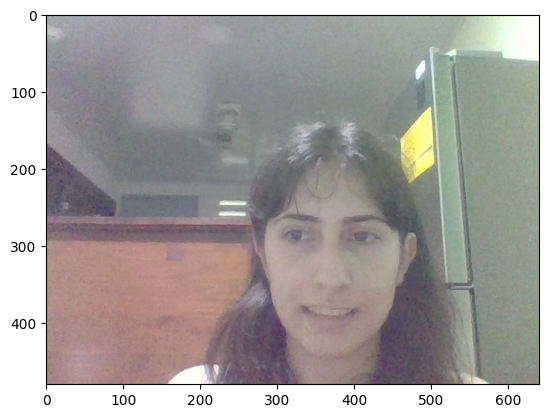

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


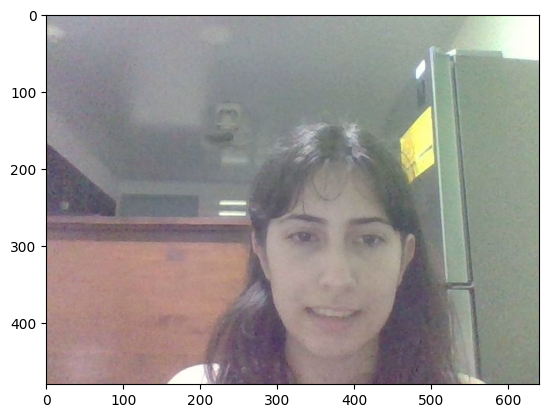

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074




In [ ]:
def show_info(Interviews):
  """ This function shows all the information of a person's diccionary.
    Argumentos:
        Interviews {list} -- List with people's dictionary's.
  """

  # Code to export all the information.
  for x in Interviews:
   print()
   c = 0
   for i,u in x.items():
     if i == 'frames':
       c = 0
       for x in x[i]:
        show_image(x[0])
        print(x[1])
        for w,y  in x[2].items():
          print(w,y)
     elif i == "children":
       print(i,":")
       for l,k in x[i].items():
         if l == "number":
           print(l,k)
         if l == 'info':
             print(l)
             for r in k:
               for v in r:
                 print(v,"")
     else:
       print(i, ": ",u)
  print()
  print()
show_info(Interviews)

#Consulta 2
Mostrar la información de todas las personas entrevistas ordenada ascendentemente por edad. El método de ordenamiento a utilizar es el método por inserción (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros


In [ ]:
#Library to know the current date.
from datetime import datetime
def knowagei(birthdate):
 now = datetime.now()
 actualyear = now.year
 date_string = birthdate
 date = datetime.strptime(date_string, "%Y/%m/%d")
 day = date.day
 month = date.month
 year = date.year
 age = actualyear - year
 return age

In [ ]:
#Library to know the current date.
from datetime import datetime
def knowage(Interviews):
 
 now = datetime.now()
 actualyear = now.year
 print(now)
 ye = 0
 mo = 0
 di = 0
 for x in Interviews:
  for i,u in x.items():
    if i == 'birth date':
     date_string = x[i]
     print(x[i])
     date = datetime.strptime(date_string, "%Y/%m/%d")
     day = date.day
     month = date.month
     year = date.year
     age = actualyear - year
 return age




In [ ]:
def saveli(list_):
 """The function gets the age of each person's dictionary and sorts it out.
    Arguments:
        list_ {list} -- Unsorted list.
    Returns:
        lista {list} -- Sorted list.
 """
 lus = []
 for x in list_:
  p = knowagei(x["birth date"])
  lus.append(p)
 lus = insertion(lus)
 return lus
saveli(Interviews)

[19, 23]

In [ ]:
def insertion(list_):
  newlis =[]
  while len(list_) >0 :
    m = list_[0]
    for x in list_:
      if x > m:
        m = x
    newlis.insert(0, m)
    list_.remove(m)
  return newlis


ID :  208500806
name :  Sharon Blanco Piedra
gender :  female
birth date :  2004/02/07
telefone :  84166154
email :  sharoniris88@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
female 
08/02/2003 
male 
09/03/2004 


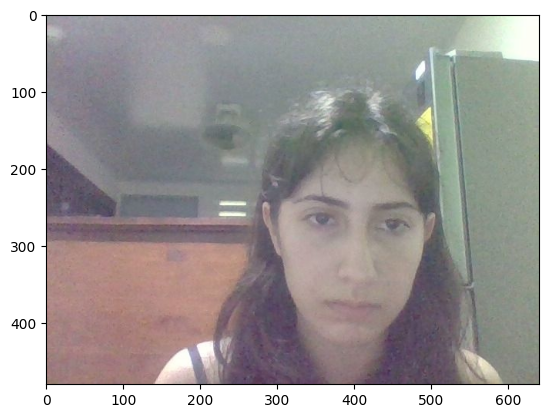

[array([[283, 174, 235, 235]], dtype=int32)]
angry 0.06920064
disgust 0.00043989267
fear 0.100069515
happiness 0.0064721704
sadness 0.3447096
surprise 0.0018441533
neutral 0.4772639


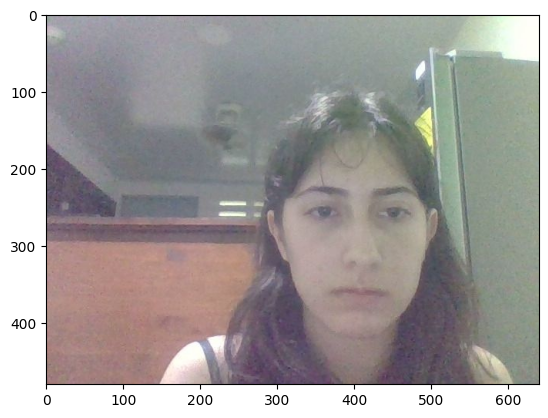

[array([[291, 166, 230, 230]], dtype=int32)]
angry 0.04641404
disgust 0.00018954767
fear 0.12724043
happiness 0.00086199417
sadness 0.5307853
surprise 0.0004992461
neutral 0.2940094


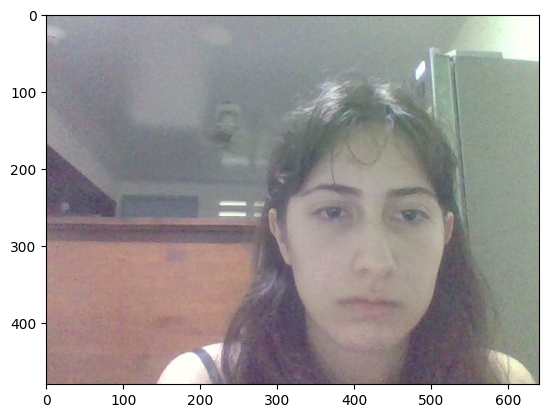

[array([[293, 157, 269, 269]], dtype=int32)]
angry 0.043305356
disgust 0.00015068507
fear 0.10444007
happiness 0.0010058512
sadness 0.50212294
surprise 0.000370827
neutral 0.34860438


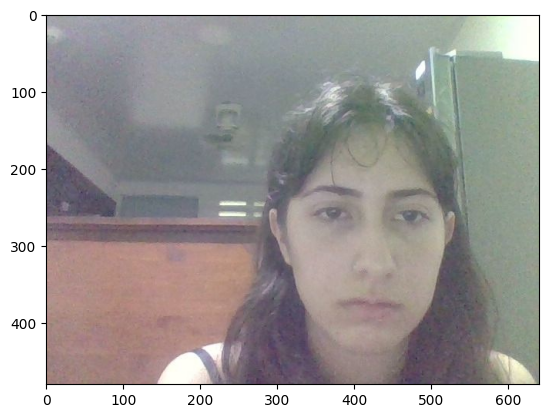

[array([[290, 159, 266, 266]], dtype=int32)]
angry 0.053196948
disgust 0.00020436705
fear 0.08568812
happiness 0.0017861807
sadness 0.44692162
surprise 0.00039068412
neutral 0.41181216


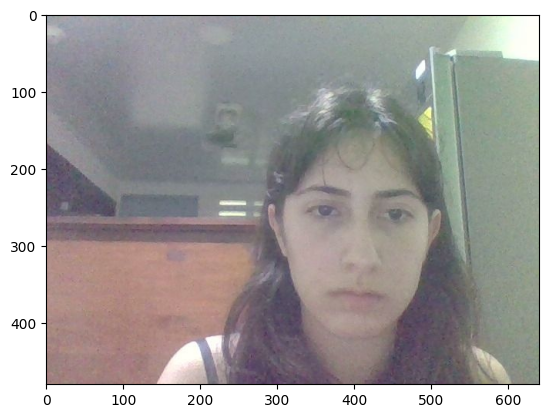

[array([[291, 167, 235, 235]], dtype=int32)]
angry 0.0694405
disgust 0.00035139945
fear 0.097089976
happiness 0.0026550014
sadness 0.39821315
surprise 0.00087876635
neutral 0.43137118

ID :  209870987
name :  Alex
gender :  male
birth date :  2003/12/02
telefone :  2939393
email :  dkdkdk
address :  ddkdk
marital status :  Single
nationality :  dd
children :
number 1
info
male 
09/04/0 


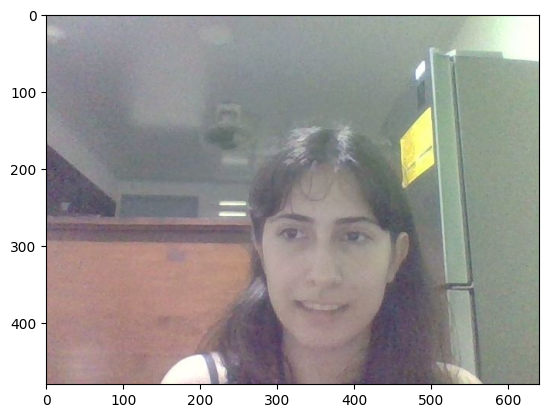

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


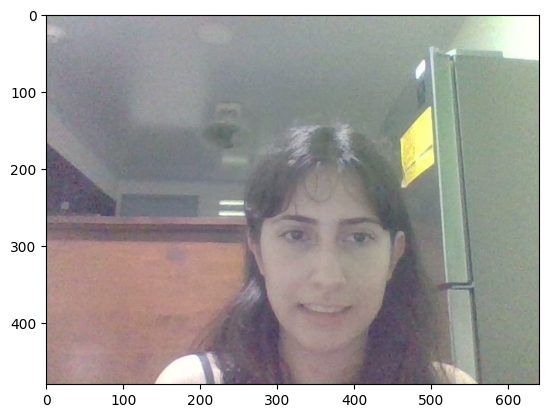

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


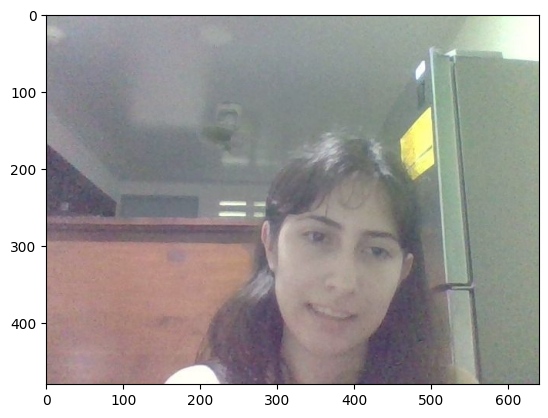

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


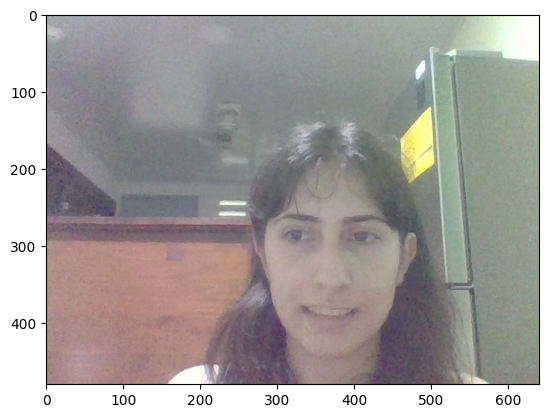

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


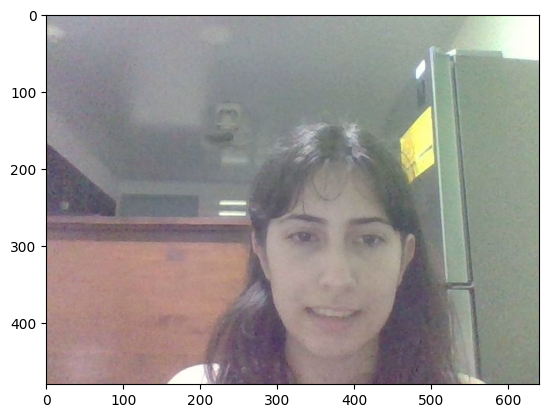

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074

ID :  20484048484
name :  Dayana Núñez
gender :  male
birth date :  2000/12/01
telefone :  84847867
email :  numexs87@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
male 
9900 
male 
9439 


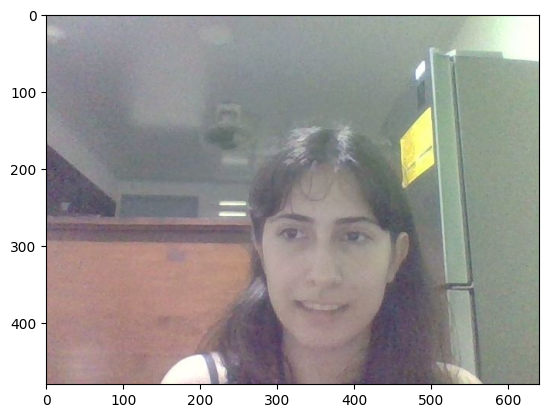

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


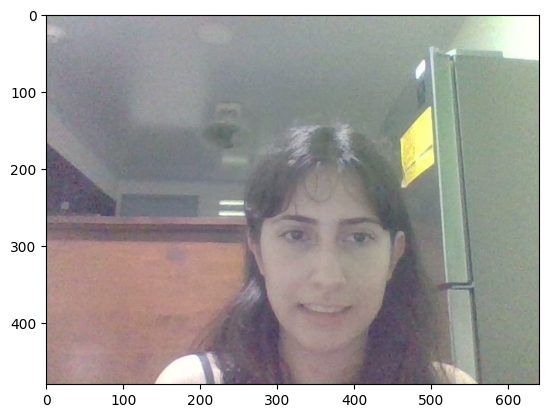

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


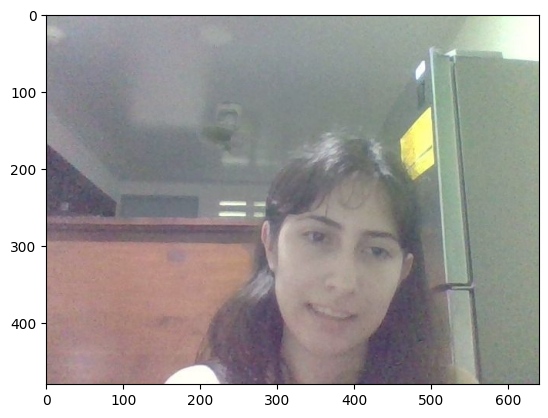

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


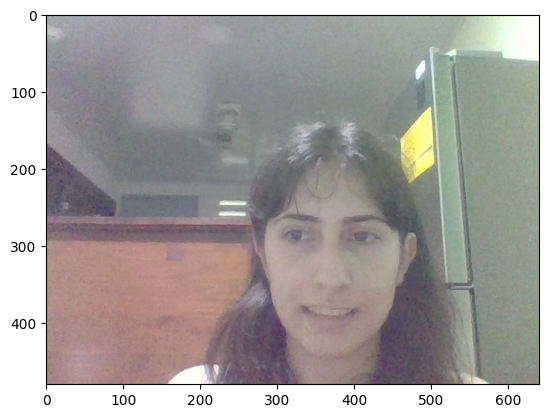

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


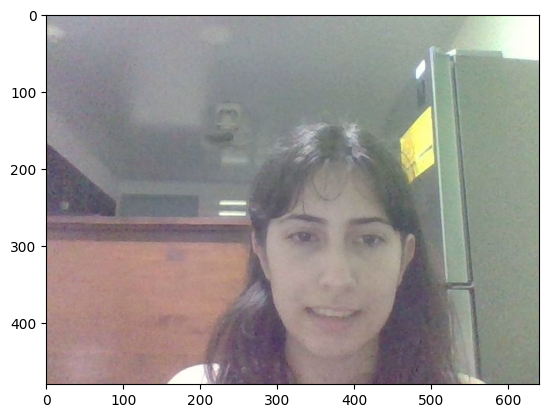

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074




In [ ]:
#Code to place show the dictionaries sorted out based on the previews conditions.
check_list = []
lis = saveli(Interviews)
lui = lis.copy()
c = 0
while len(lui) > 0:
  c = 0
  d = lui[c]
  for x in Interviews:
    if knowagei(x['birth date']) == d:
     check_list.append(x)
     lui.remove(d)
     c = c + 1
show_info(check_list)

#Consulta 3
Mostrar la información de todas las personas entrevistas ordenada descendente mente por la cantidad de hijos. El método de ordenamiento a utilizar es el método por de la bubuja (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

In [ ]:
def bubble(list_):
    """This function takes a list and sorts it by the bubble method.
    Arguments:
        list_ {list} -- Unsorted list.
    Returns:
        list_ {list} -- Sorted list
    """
    times =len(list_)-1
    while times>0:
        pos=0
        while pos < times:
            if list_[pos] < list_[pos+1]:
                temp=list_[pos]
                list_[pos]=list_[pos+1]
                list_[pos+1]=temp
            pos=pos+1
        times = times -1
    return list_


In [ ]:
def savelis(list_):
 """The function gets the number of children of each person's dictionary and sorts it out.
    Arguments:
        list_ {list} -- Unsorted list.
    Returns:
        lista {list} -- Sorted list.
 """
 lus = []
 for x in list_:
  lus.append(x["children"]["number"])
 lus = bubble(lus)
 return lus


ID :  208500806
name :  Sharon Blanco Piedra
gender :  female
birth date :  2004/02/07
telefone :  84166154
email :  sharoniris88@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
female 
08/02/2003 
male 
09/03/2004 


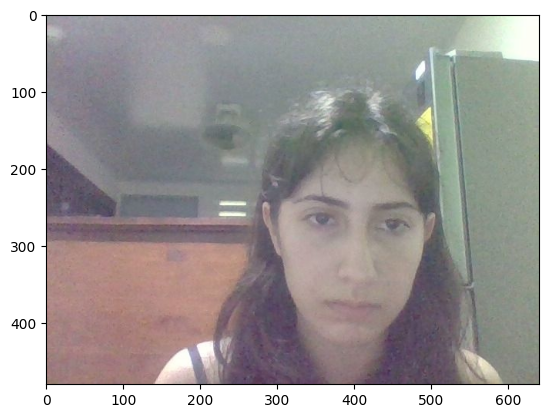

[array([[283, 174, 235, 235]], dtype=int32)]
angry 0.06920064
disgust 0.00043989267
fear 0.100069515
happiness 0.0064721704
sadness 0.3447096
surprise 0.0018441533
neutral 0.4772639


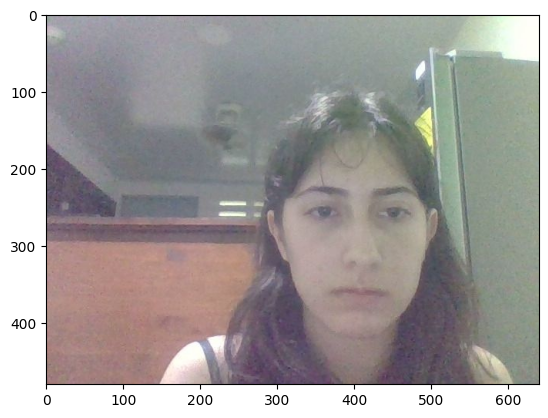

[array([[291, 166, 230, 230]], dtype=int32)]
angry 0.04641404
disgust 0.00018954767
fear 0.12724043
happiness 0.00086199417
sadness 0.5307853
surprise 0.0004992461
neutral 0.2940094


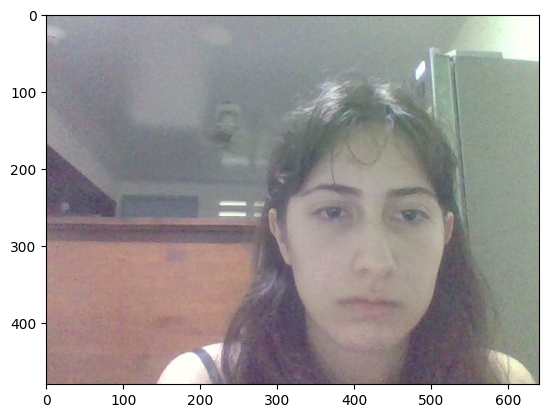

[array([[293, 157, 269, 269]], dtype=int32)]
angry 0.043305356
disgust 0.00015068507
fear 0.10444007
happiness 0.0010058512
sadness 0.50212294
surprise 0.000370827
neutral 0.34860438


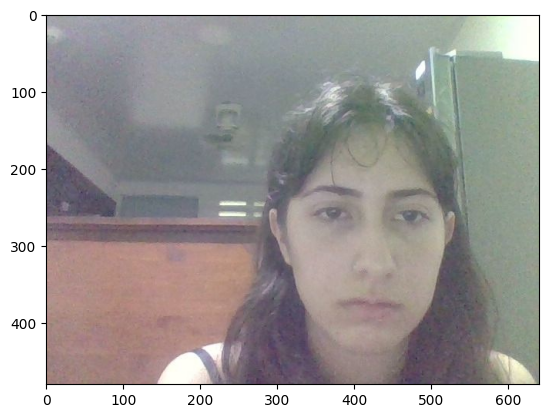

[array([[290, 159, 266, 266]], dtype=int32)]
angry 0.053196948
disgust 0.00020436705
fear 0.08568812
happiness 0.0017861807
sadness 0.44692162
surprise 0.00039068412
neutral 0.41181216


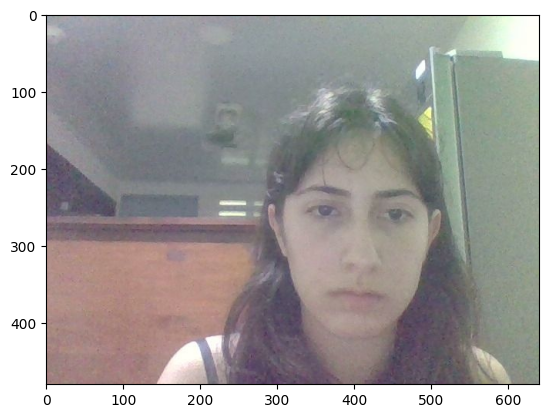

[array([[291, 167, 235, 235]], dtype=int32)]
angry 0.0694405
disgust 0.00035139945
fear 0.097089976
happiness 0.0026550014
sadness 0.39821315
surprise 0.00087876635
neutral 0.43137118

ID :  20484048484
name :  Dayana Núñez
gender :  male
birth date :  2000/12/01
telefone :  84847867
email :  numexs87@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
male 
9900 
male 
9439 


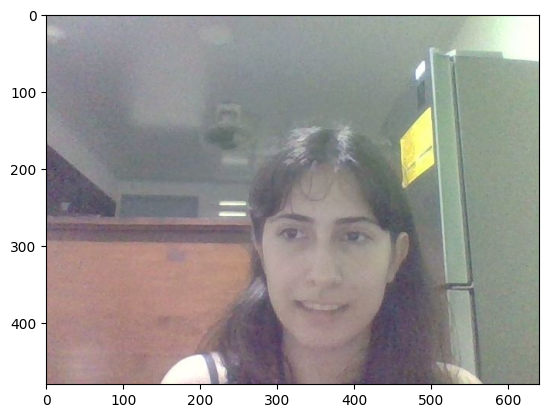

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


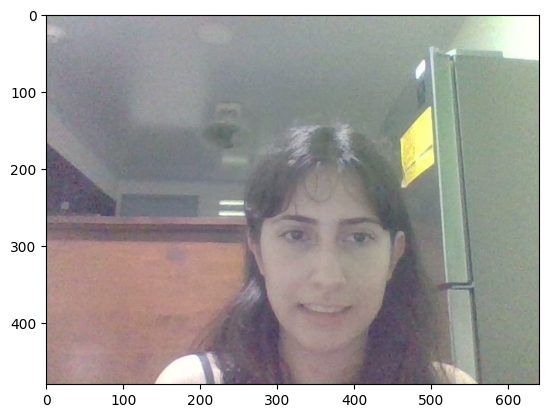

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


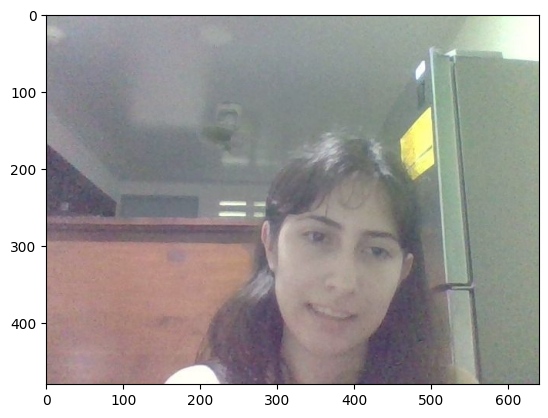

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


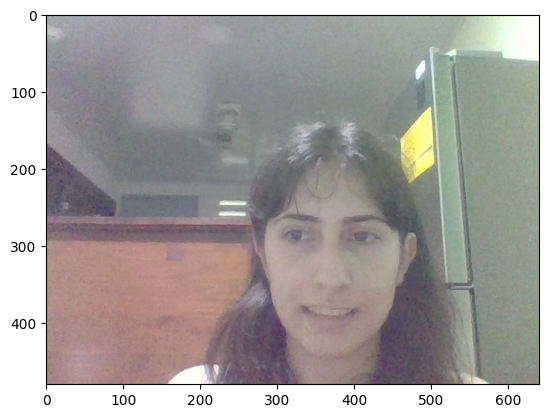

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


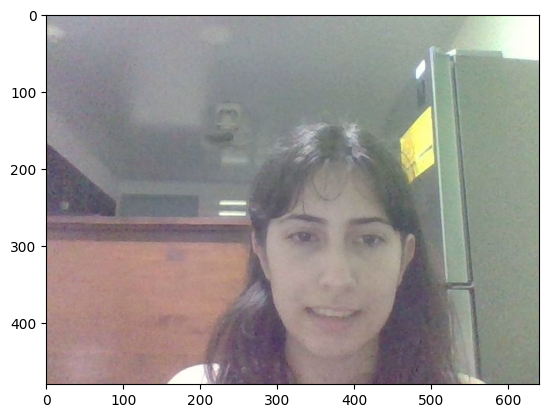

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074

ID :  209870987
name :  Alex
gender :  male
birth date :  2003/12/02
telefone :  2939393
email :  dkdkdk
address :  ddkdk
marital status :  Single
nationality :  dd
children :
number 1
info
male 
09/04/0 


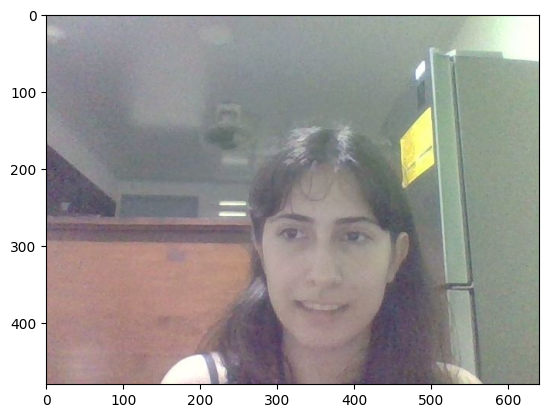

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


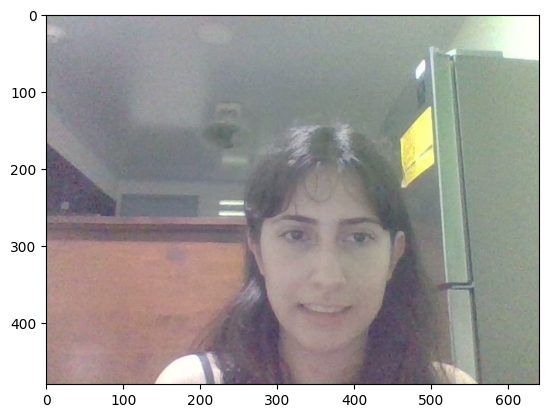

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


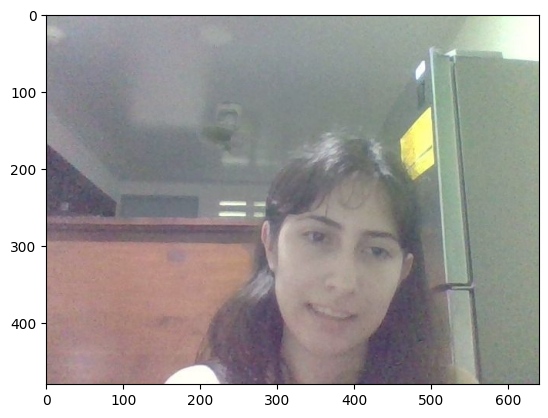

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


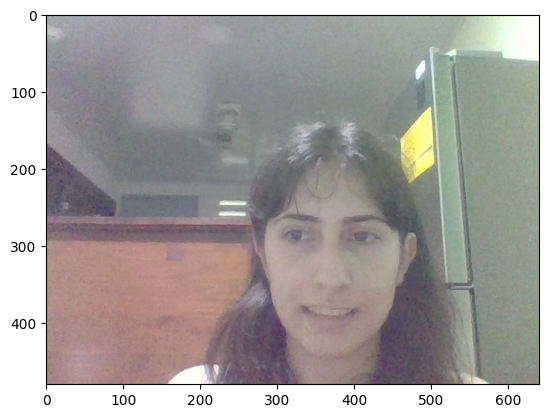

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


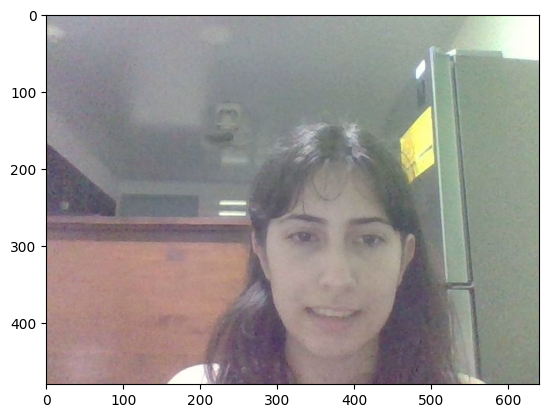

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074




In [ ]:
#Code to place show the dictionaries sorted out based on the previews conditions.
check_list = []
lis = savelis(Interviews)
lui = lis.copy()
c = 0
while len(lui) > 0:
  c = 0
  d = lui[c]
  for x in Interviews:
    if x['children']['number'] == d:
     check_list.append(x)
     lui.remove(d)
     c = c + 1
show_info(check_list)

#Consulta 4

Mostrar la información de todas las personas entrevistas ordenada descendentemente por la cantidad de hijos. El método de ordenamiento a utilizar es el método por de la quicksort (la información debe ser mostrada siendo saca de los diccionarios o listas, no se debe hacer simplemente la impresión en pantalla de los diccionarios o las listas). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros. También, imprimir una lista con sublistas donde la primera sublista tiene la información de las personas que tienen únicamente hijos de género femenino, la segunda sublista tiene información de personas que tienen únicamente hijos de género masculino y la última sublista tiene información de personas que tienen hijos tanto de género femenino como másculino.

In [ ]:
def divide_list(liss):
    """Arguments:
        liss {list} -- Unsorted list.
    Returns:
        [bigger,pivot,smaller] {list} -- List with sublists with the smaller values, the pivot and the bigger values.
    """
    smaller = []
    bigger= []
    pivot=liss[-1]
    for x in liss[:-1]:
        if x < pivot:
            smaller.append(x)
        else:
            bigger.append(x) 
    return([smaller,pivot,bigger])

In [ ]:
def quickSort(Interviews):
    """The function sorts out a list using the quicksort method.
    Arguments:
        Interviews {list} -- List of people's dictionaries. 
    Returns:
        Interviews {list} -- List of people's dictionaries sorted out based on the amount of children they have.
    """
    if len(Interviews)>0:
        Interviews = divide_list(Interviews)
        cont=0
        while cont<len(Interviews):
            e=Interviews[cont]
            if type(e)==list:
                if len(e)==0:
                    del Interviews[cont]
                elif len(e)==1:
                    Interviews[cont]=e[0]
                    cont = cont + 1
                else:
                    Interviews=Interviews[:cont]+divide_list(e)+Interviews[cont+1:]
            else:
                cont=cont+1
            
    return Interviews

In [ ]:
def savelist(list_):
 """The function gets the number of children of each person's dictionary and sorts it out.
    Arguments:
        list_ {list} -- Unsorted list.
    Returns:
        lista {list} -- Sorted list.
 """
 lus = []
 for x in list_:
  lus.append(x["children"]["number"])
 lus = quickSort(lus)
 return lus


ID :  209870987
name :  Alex
gender :  male
birth date :  2003/12/02
telefone :  2939393
email :  dkdkdk
address :  ddkdk
marital status :  Single
nationality :  dd
children :
number 1
info
male 
09/04/0 


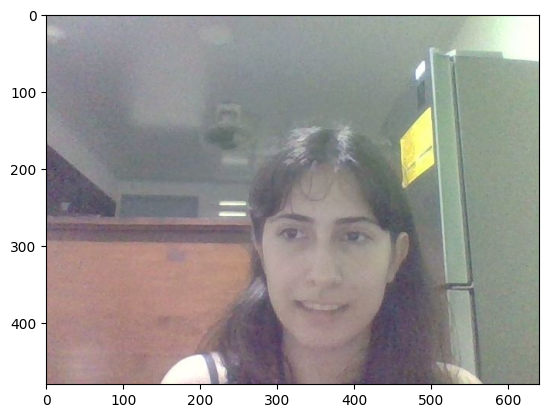

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


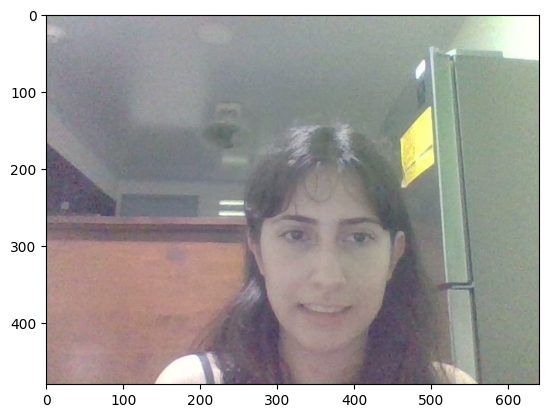

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


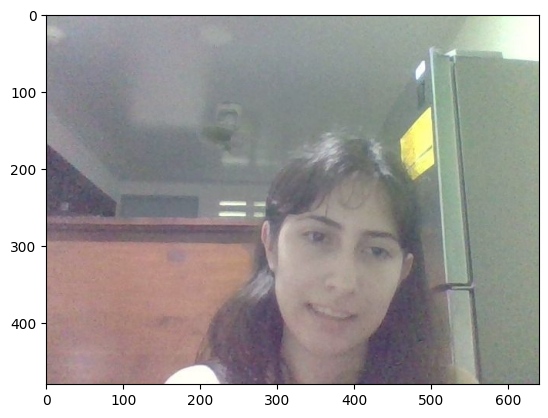

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


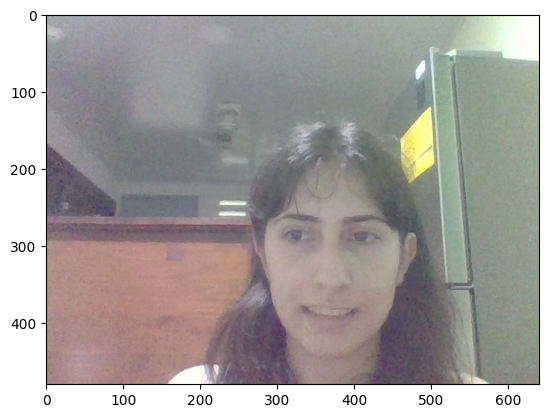

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


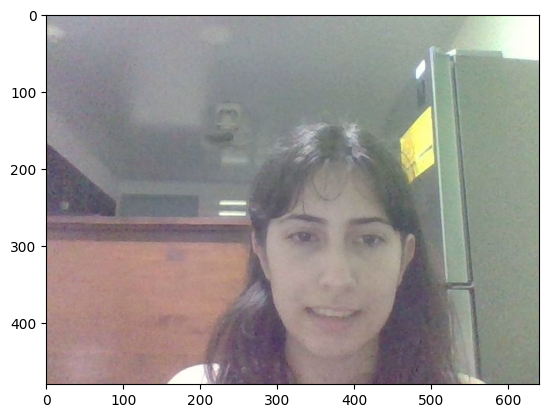

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074

ID :  208500806
name :  Sharon Blanco Piedra
gender :  female
birth date :  2004/02/07
telefone :  84166154
email :  sharoniris88@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
female 
08/02/2003 
male 
09/03/2004 


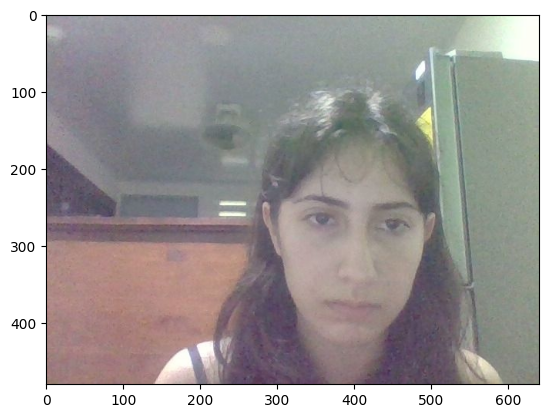

[array([[283, 174, 235, 235]], dtype=int32)]
angry 0.06920064
disgust 0.00043989267
fear 0.100069515
happiness 0.0064721704
sadness 0.3447096
surprise 0.0018441533
neutral 0.4772639


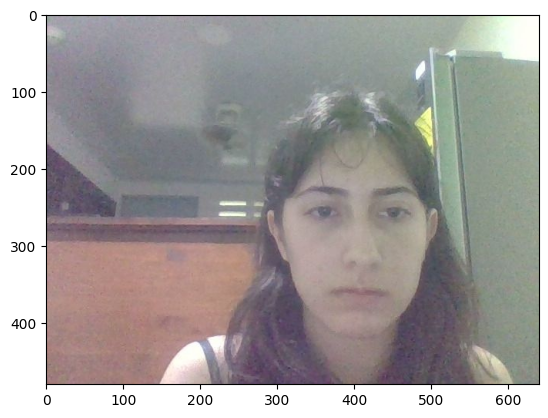

[array([[291, 166, 230, 230]], dtype=int32)]
angry 0.04641404
disgust 0.00018954767
fear 0.12724043
happiness 0.00086199417
sadness 0.5307853
surprise 0.0004992461
neutral 0.2940094


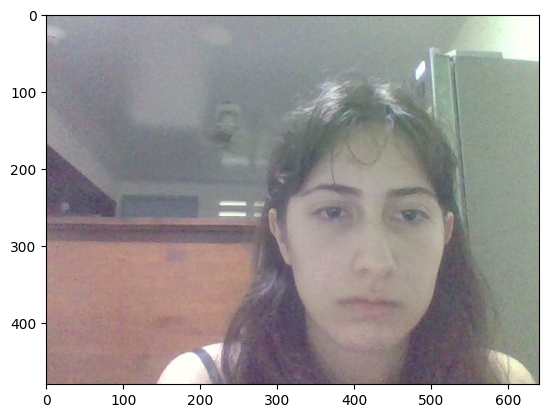

[array([[293, 157, 269, 269]], dtype=int32)]
angry 0.043305356
disgust 0.00015068507
fear 0.10444007
happiness 0.0010058512
sadness 0.50212294
surprise 0.000370827
neutral 0.34860438


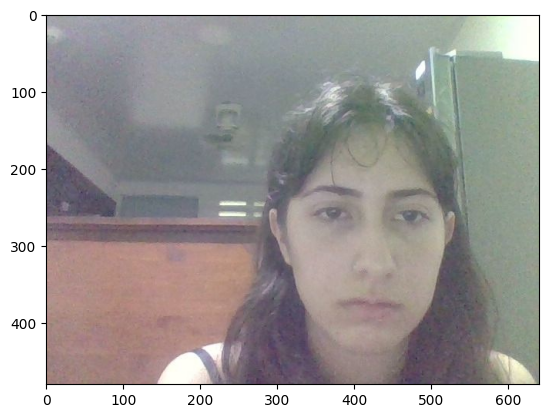

[array([[290, 159, 266, 266]], dtype=int32)]
angry 0.053196948
disgust 0.00020436705
fear 0.08568812
happiness 0.0017861807
sadness 0.44692162
surprise 0.00039068412
neutral 0.41181216


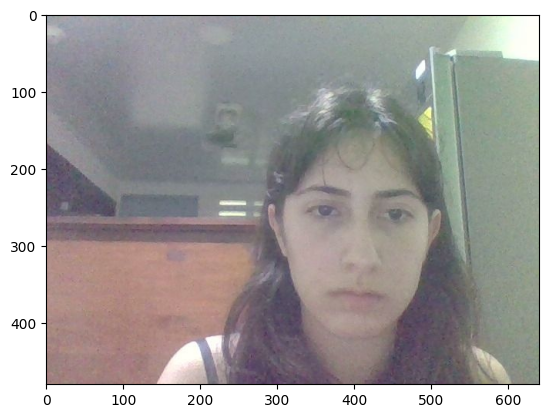

[array([[291, 167, 235, 235]], dtype=int32)]
angry 0.0694405
disgust 0.00035139945
fear 0.097089976
happiness 0.0026550014
sadness 0.39821315
surprise 0.00087876635
neutral 0.43137118

ID :  20484048484
name :  Dayana Núñez
gender :  male
birth date :  2000/12/01
telefone :  84847867
email :  numexs87@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
male 
9900 
male 
9439 


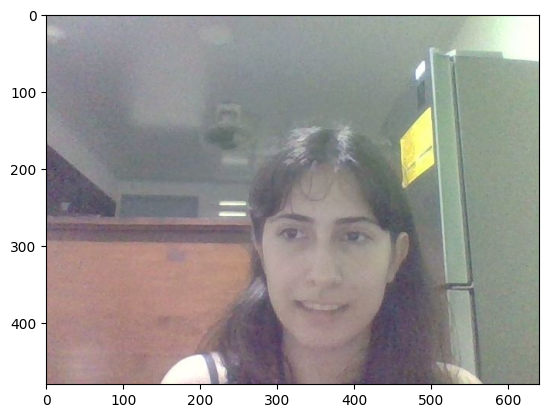

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


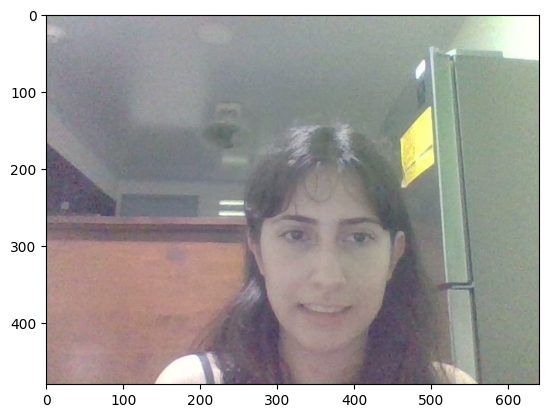

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


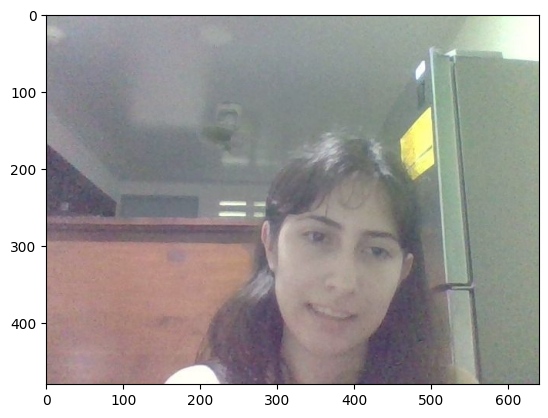

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


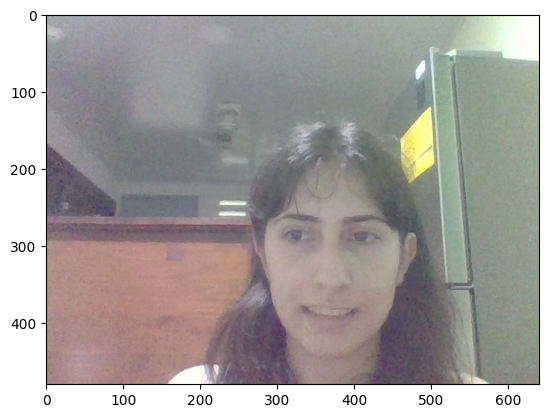

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


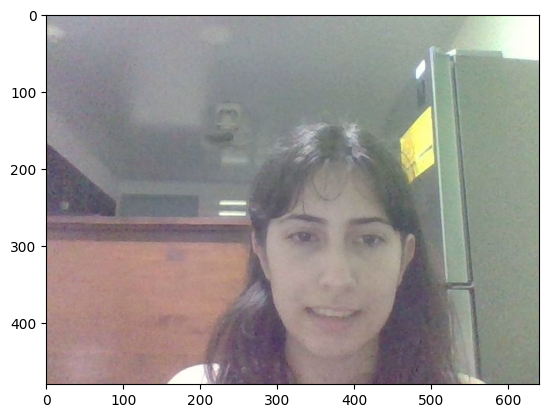

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074




In [ ]:
#Code to place show the dictionaries sorted out based on the previews conditions.
check_list = []
lis = savelist(Interviews)
lui = lis.copy()
c = 0
while len(lui) > 0:
  c = 0
  d = lui[c]
  for x in Interviews:
    if x['children']['number'] == d:
     check_list.append(x)
     lui.remove(d)
     c = c + 1
show_info(check_list)

[
[]
[

ID :  208500806
name :  Sharon Blanco Piedra
gender :  female
birth date :  2004/02/07
telefone :  84166154
email :  sharoniris88@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
female 
08/02/2003 
male 
09/03/2004 


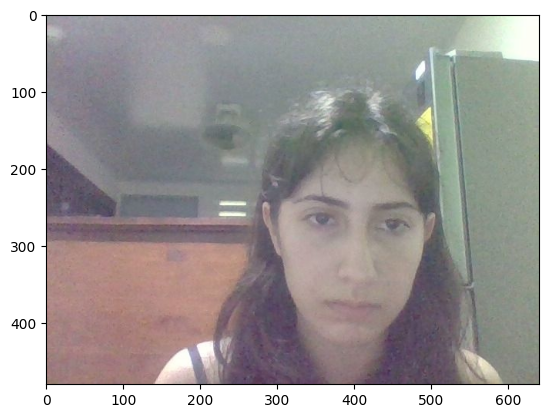

[array([[283, 174, 235, 235]], dtype=int32)]
angry 0.06920064
disgust 0.00043989267
fear 0.100069515
happiness 0.0064721704
sadness 0.3447096
surprise 0.0018441533
neutral 0.4772639


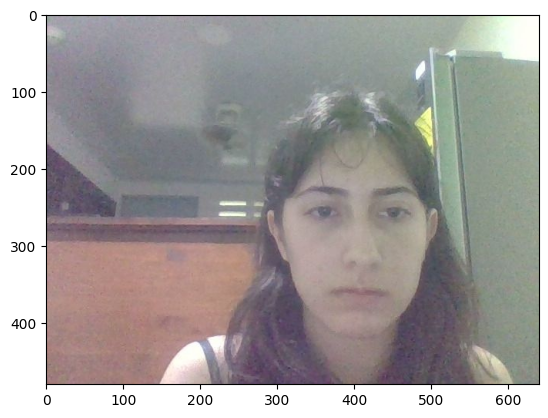

[array([[291, 166, 230, 230]], dtype=int32)]
angry 0.04641404
disgust 0.00018954767
fear 0.12724043
happiness 0.00086199417
sadness 0.5307853
surprise 0.0004992461
neutral 0.2940094


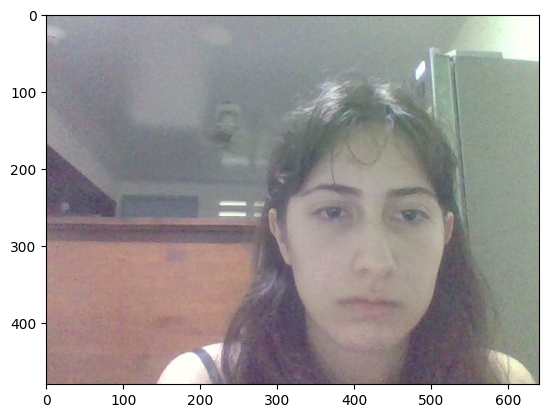

[array([[293, 157, 269, 269]], dtype=int32)]
angry 0.043305356
disgust 0.00015068507
fear 0.10444007
happiness 0.0010058512
sadness 0.50212294
surprise 0.000370827
neutral 0.34860438


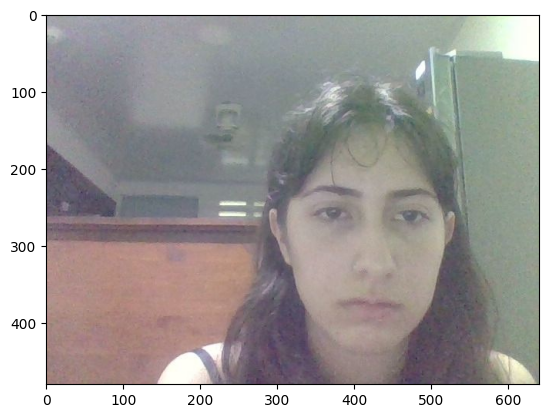

[array([[290, 159, 266, 266]], dtype=int32)]
angry 0.053196948
disgust 0.00020436705
fear 0.08568812
happiness 0.0017861807
sadness 0.44692162
surprise 0.00039068412
neutral 0.41181216


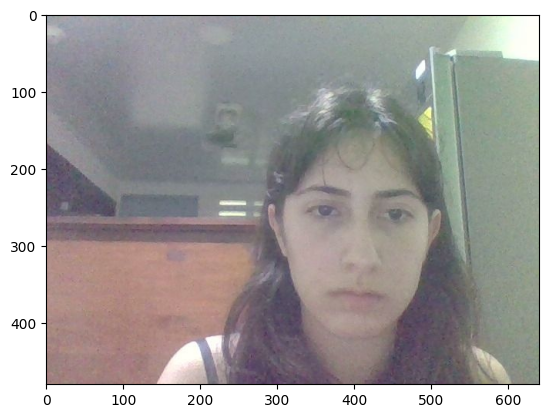

[array([[291, 167, 235, 235]], dtype=int32)]
angry 0.0694405
disgust 0.00035139945
fear 0.097089976
happiness 0.0026550014
sadness 0.39821315
surprise 0.00087876635
neutral 0.43137118


]
[

ID :  20484048484
name :  Dayana Núñez
gender :  male
birth date :  2000/12/01
telefone :  84847867
email :  numexs87@gmail.com
address :  300 mts Este del Aserradero
marital status :  Single
nationality :  Costa Rican
children :
number 2
info
male 
9900 
male 
9439 


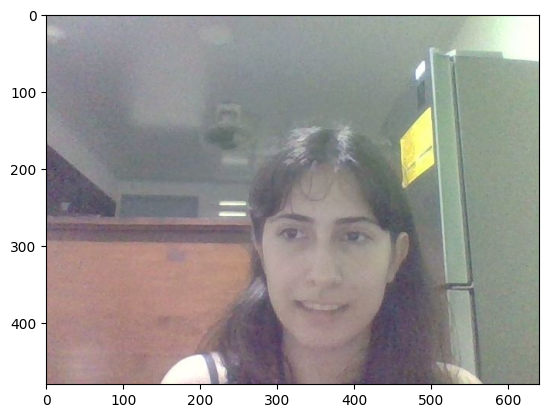

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


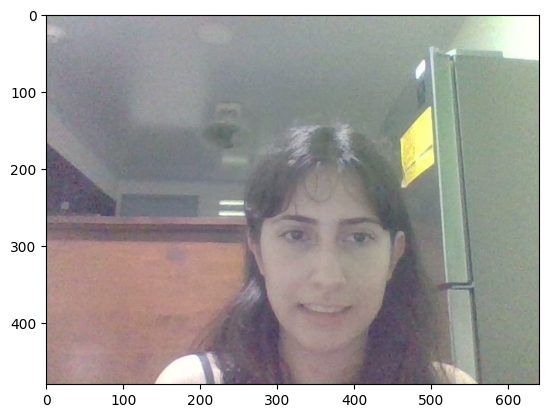

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


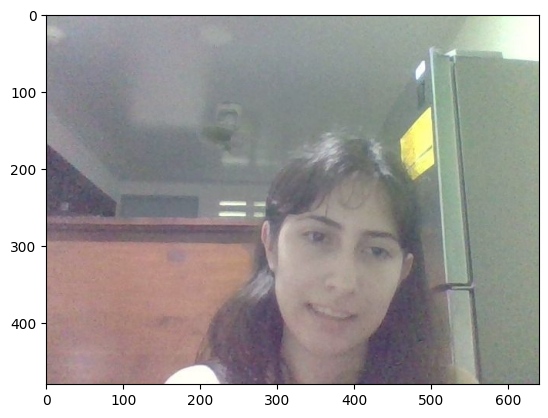

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


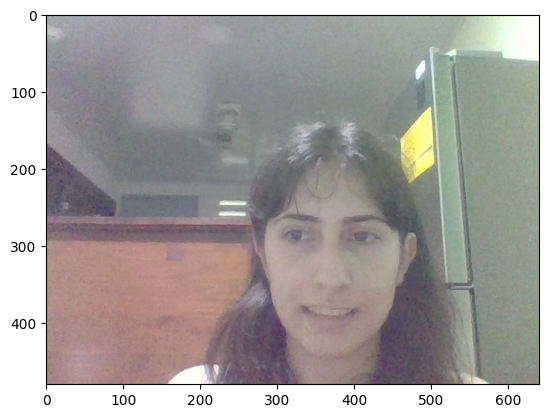

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


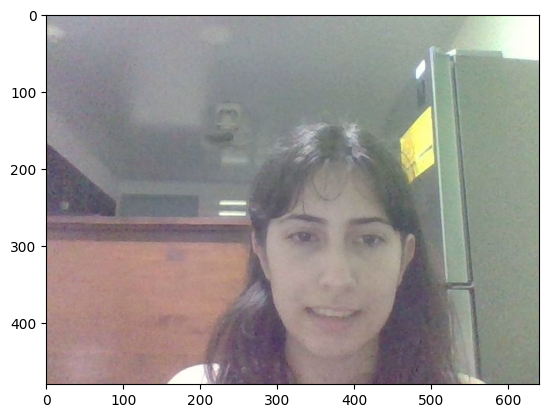

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074

ID :  209870987
name :  Alex
gender :  male
birth date :  2003/12/02
telefone :  2939393
email :  dkdkdk
address :  ddkdk
marital status :  Single
nationality :  dd
children :
number 1
info
male 
09/04/0 


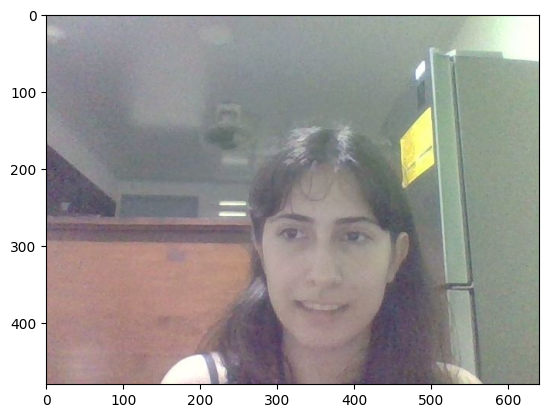

[array([[257, 209, 210, 210]], dtype=int32)]
angry 0.0023908534
disgust 2.9288429e-05
fear 0.0012879692
happiness 0.8479271
sadness 0.004396704
surprise 0.0013342951
neutral 0.14263377


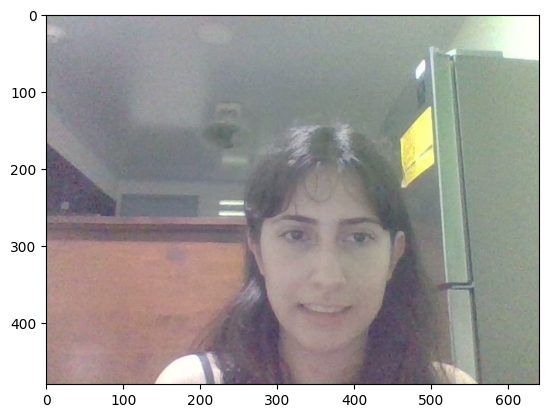

[array([[260, 207, 214, 214]], dtype=int32)]
angry 0.0023597004
disgust 3.2515112e-05
fear 0.001684274
happiness 0.90621316
sadness 0.004429114
surprise 0.0017105339
neutral 0.08357073


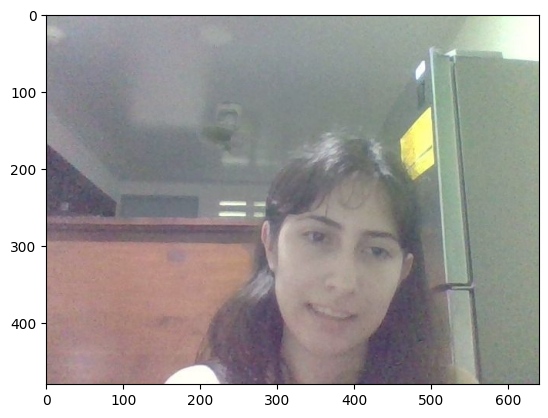

[array([[291, 218, 208, 208]], dtype=int32)]
angry 0.008994338
disgust 0.00017396099
fear 0.004458463
happiness 0.65414554
sadness 0.01717083
surprise 0.002509353
neutral 0.31254753


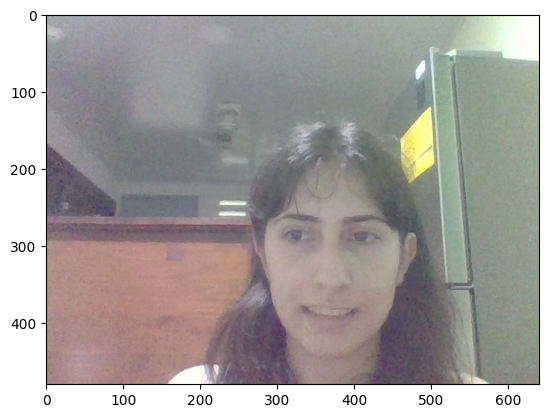

[array([[261, 207, 217, 217]], dtype=int32)]
angry 0.0025828255
disgust 3.5675464e-05
fear 0.0019907944
happiness 0.8573769
sadness 0.0053822594
surprise 0.0022128662
neutral 0.13041864


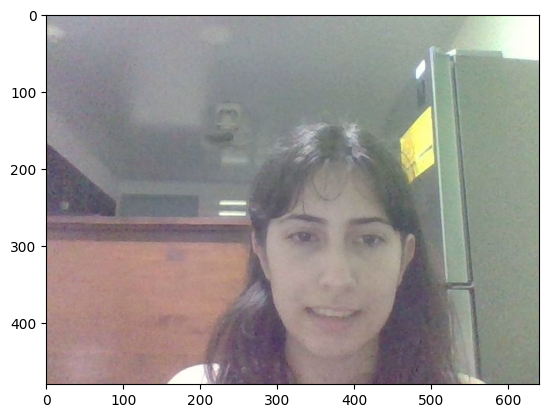

[array([[276, 216, 204, 204]], dtype=int32)]
angry 0.0026948925
disgust 4.3174914e-05
fear 0.0023507725
happiness 0.8370212
sadness 0.0077096024
surprise 0.002089745
neutral 0.14809074


]
]


In [ ]:
def classify(Interviews):
  """The function creates a list with sublists, one with the information of people with only female children, 
  another one with only male children and the last one with both.
    Arguments:
        Interviews {list} -- List with all dictionaries.
    Returns:
        lista {list} -- Sorted list.
  """
  male = []
  female = []
  both = []
  for x in Interviews:
    if x['children']['number'] != 0:
      enter = True
      for i in x['children']['info']:
        if i[0] == 'female' and x not in female and x not in male:
            female.append(x)
        if i[0] == "male" and x not in male and x not in female:
          male.append(x)
        if i[0] == "male" and x in female:
          female.remove(x)
          both.append(x)
        if i[0] == "female" and x in male:
          male.remove(x)
          both.append(x)
  check_list= [female, both, male]
  print("[")
  for x in check_list:
    if x == []:
      print(x)
    if x != []:
     print("[")
     show_info(x)
     print("]")
  print("]")
classify(Interviews)

#Consulta 5

Obtener para cada persona entrevistada las emociones sin ordenar y guardar en una lista (una lista por entrevista) con sublistas la siguiente información: en la primera sublista colocar la identificación, el nombre, el género y la edad de la persona entrevistada, en las siguientes sublistas colocar las emociones expresadas por la persona. Por ejemplo, si la persona apareció en 10 fotogramas entonces se deben crear 10 sublistas, cada sublista pertenece a las emociones emitidas por el candidato en un fotograma.

In [ ]:
def sublists(Interviews): 
 generallist = []
 newl = []
 for x in Interviews:
   person_lis = []
   for i, u in x.items():
      if i == "ID":
        person_lis.append(u)
      if i == "name":
        person_lis.append(u)
      if i == "gender":
        person_lis.append(u)
      if i == "birth date":
        p = knowagei(u)
        person_lis.append(p)
      if i == "frames":
         for x in x[i]: 
          emotion_list = []
          emotion_list.append(x[2])
          newl.append(emotion_list)
   newl.insert(0, person_lis)
   generallist.append(newl)
   newl = []

 return generallist
sublists(Interviews)
  

[[[208500806, 'Sharon Blanco Piedra', 'female', 19],
  [{'angry': 0.06920064,
    'disgust': 0.00043989267,
    'fear': 0.100069515,
    'happiness': 0.0064721704,
    'sadness': 0.3447096,
    'surprise': 0.0018441533,
    'neutral': 0.4772639}],
  [{'angry': 0.04641404,
    'disgust': 0.00018954767,
    'fear': 0.12724043,
    'happiness': 0.00086199417,
    'sadness': 0.5307853,
    'surprise': 0.0004992461,
    'neutral': 0.2940094}],
  [{'angry': 0.043305356,
    'disgust': 0.00015068507,
    'fear': 0.10444007,
    'happiness': 0.0010058512,
    'sadness': 0.50212294,
    'surprise': 0.000370827,
    'neutral': 0.34860438}],
  [{'angry': 0.053196948,
    'disgust': 0.00020436705,
    'fear': 0.08568812,
    'happiness': 0.0017861807,
    'sadness': 0.44692162,
    'surprise': 0.00039068412,
    'neutral': 0.41181216}],
  [{'angry': 0.0694405,
    'disgust': 0.00035139945,
    'fear': 0.097089976,
    'happiness': 0.0026550014,
    'sadness': 0.39821315,
    'surprise': 0.00087876

#Consulta 6
Una vez creada esta listas (una por entrevista) con sublistas del punto anterior, se debe ordenar las sublistas de forma ascendente por la emoción felicidad (happiness) utilizando el técnica de ordenamiento Quicksort.

In [ ]:
def divide_list(liss):
    """Arguments:
        liss {list} -- Unsorted list.
    Returns:
        [bigger,pivot,smaller] {list} -- List with sublists with the smaller values, the pivot and the bigger values.
    """
    smaller = []
    bigger= []
    pivot=liss[-1]
    for x in liss[:-1]:
        if x < pivot:
            smaller.append(x)
        else:
            bigger.append(x) 
    return([smaller,pivot,bigger])

In [ ]:
def quickSort(Interviews):
    """The function sorts out a list using the quicksort method.
    Arguments:
        Interviews {list} -- List of people's dictionaries. 
    Returns:
        Interviews {list} -- List of people's dictionaries sorted out based on the amount of children they have.
    """
    if len(Interviews)>0:
        Interviews = divide_list(Interviews)
        cont=0
        while cont<len(Interviews):
            e=Interviews[cont]
            if type(e)==list:
                if len(e)==0:
                    del Interviews[cont]
                elif len(e)==1:
                    Interviews[cont]=e[0]
                    cont = cont + 1
                else:
                    Interviews=Interviews[:cont]+divide_list(e)+Interviews[cont+1:]
            else:
                cont=cont+1
            
    return Interviews

In [ ]:
# Code to sort the lists based on the emotion happiness
b = sublists(Interviews)
t = b.copy()
new_n = []
while len(t)> 0:
 for x in t:
    # print(x)
    for i in x:
      # print(i)
      for r in i:
        # print(r)
        if type(r) == dict:
          m = 0
          for e, y in r.items():
            if e == "happiness":
              if y > m:
                m = y
                c = x
 new_n.append(c)
 t.remove(x)
print(new_n)


            



[[[209870987, 'Alex', 'male', 20], [{'angry': 0.0023908534, 'disgust': 2.9288429e-05, 'fear': 0.0012879692, 'happiness': 0.8479271, 'sadness': 0.004396704, 'surprise': 0.0013342951, 'neutral': 0.14263377}], [{'angry': 0.0023597004, 'disgust': 3.2515112e-05, 'fear': 0.001684274, 'happiness': 0.90621316, 'sadness': 0.004429114, 'surprise': 0.0017105339, 'neutral': 0.08357073}], [{'angry': 0.008994338, 'disgust': 0.00017396099, 'fear': 0.004458463, 'happiness': 0.65414554, 'sadness': 0.01717083, 'surprise': 0.002509353, 'neutral': 0.31254753}], [{'angry': 0.0025828255, 'disgust': 3.5675464e-05, 'fear': 0.0019907944, 'happiness': 0.8573769, 'sadness': 0.0053822594, 'surprise': 0.0022128662, 'neutral': 0.13041864}], [{'angry': 0.0026948925, 'disgust': 4.3174914e-05, 'fear': 0.0023507725, 'happiness': 0.8370212, 'sadness': 0.0077096024, 'surprise': 0.002089745, 'neutral': 0.14809074}]], [[20484048484, 'Dayana Núñez', 'male', 23], [{'angry': 0.0023908534, 'disgust': 2.9288429e-05, 'fear': 0.0

#Consulta 7

Para cada persona entrevistada muestre un gráfico para comparar las emociones reportadas durante la entrevista.

Sharon Blanco Piedra


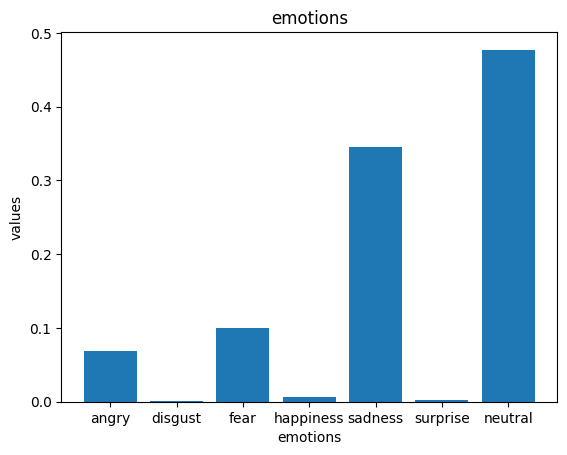

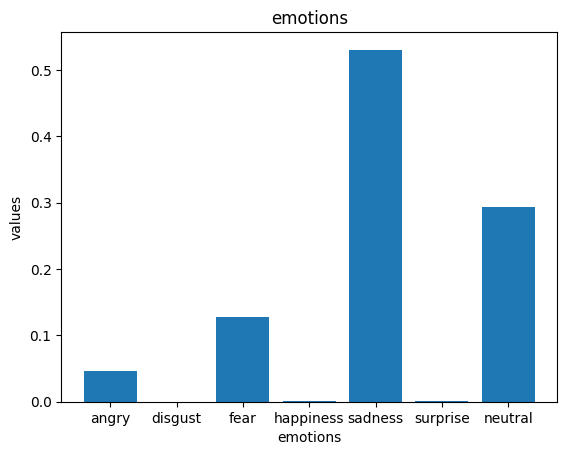

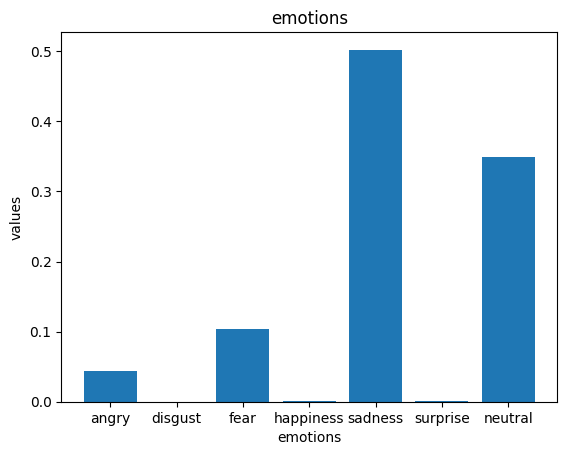

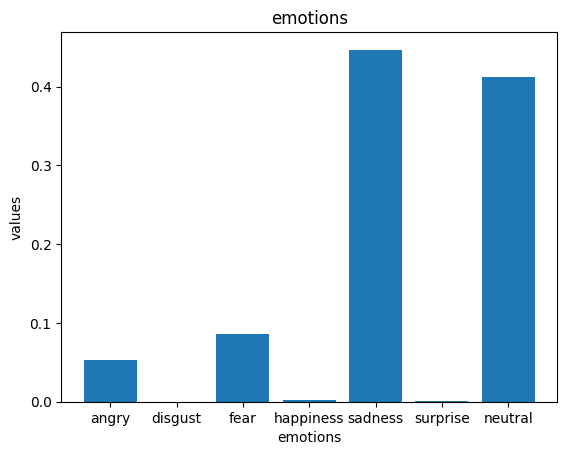

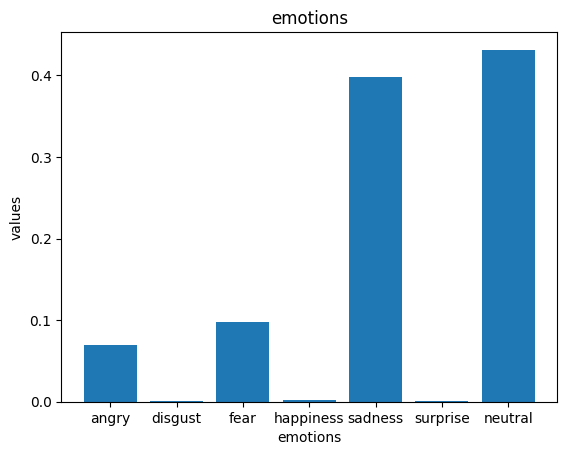

Dayana Núñez


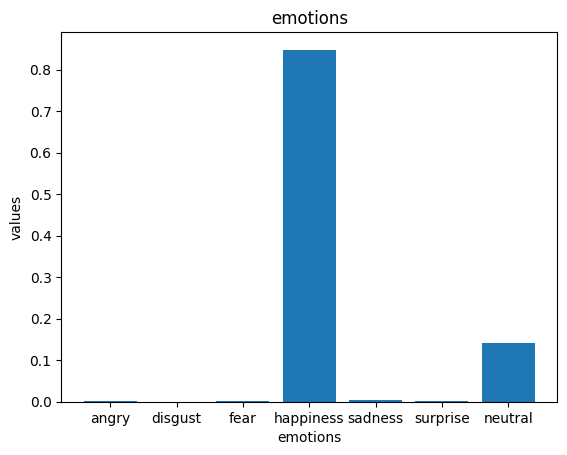

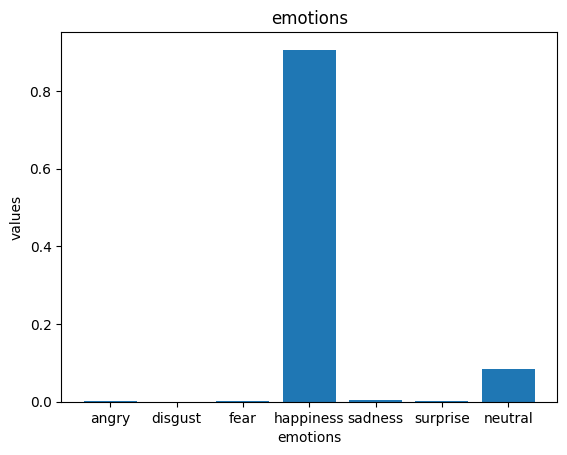

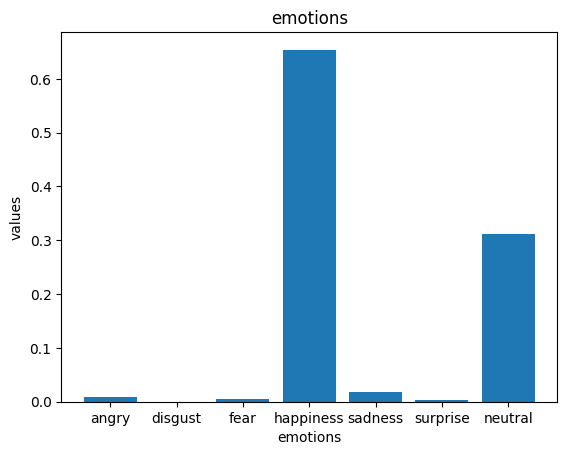

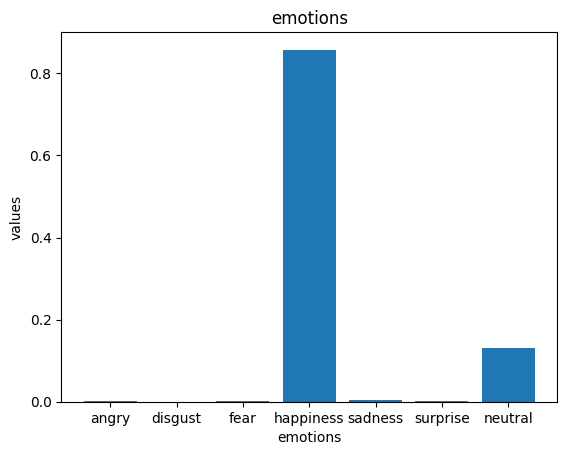

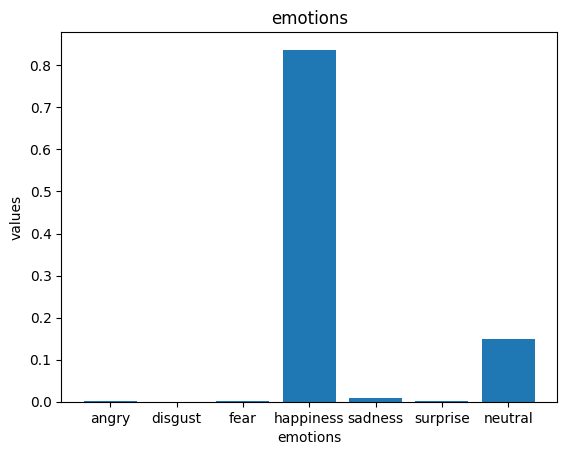

Alex


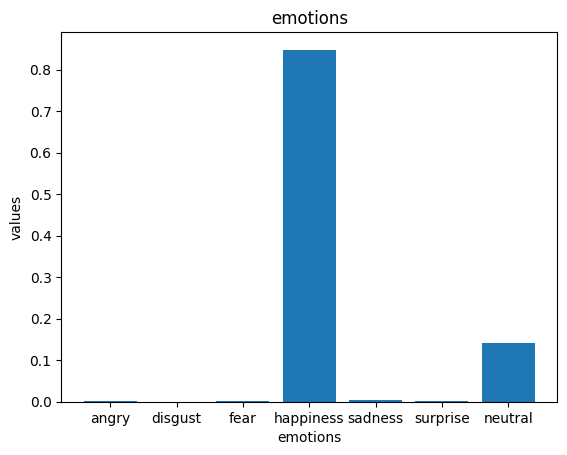

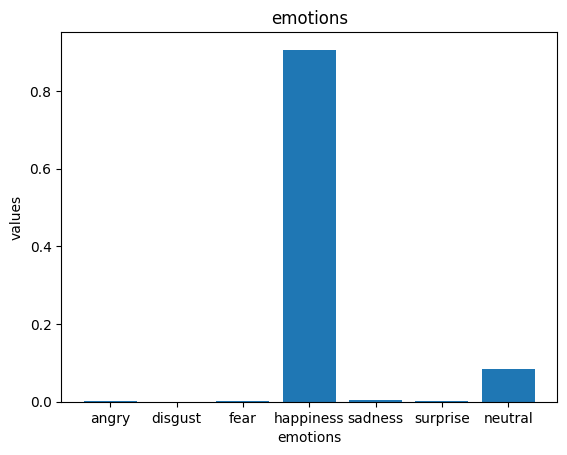

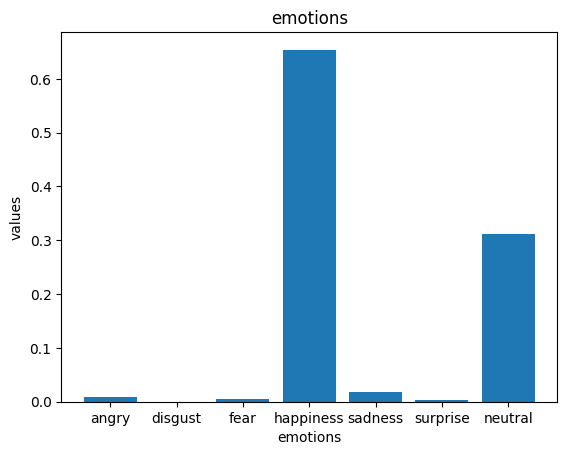

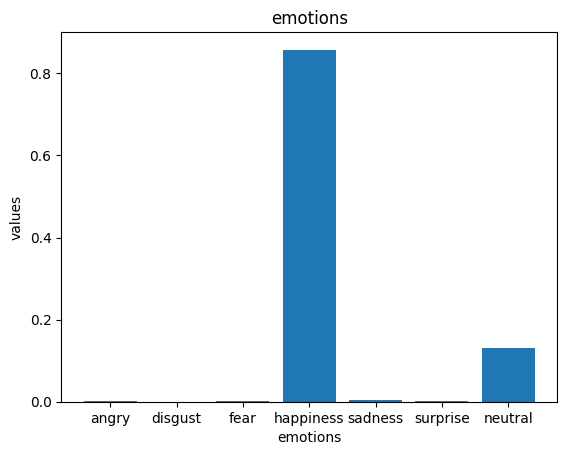

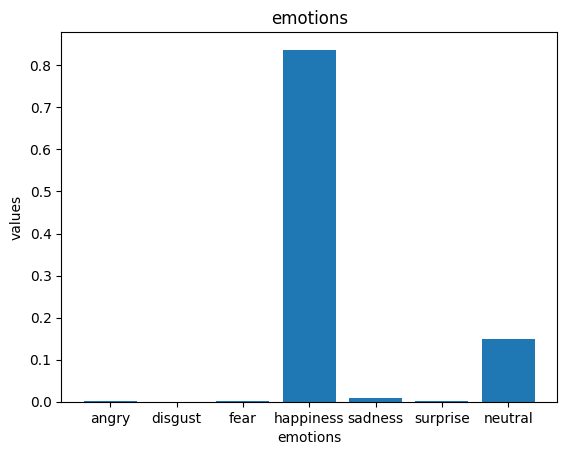

In [ ]:
#Library to create a graphic.
import matplotlib.pyplot as plt
#This code access to the emotions dictionaries and creates a graphic for each one of them.
for x in Interviews:
   c = 0
   for i,u in x.items():
     if i == 'name':
       print(x[i])
     if i == 'frames':
       for x in x[i]:
         emotion = x[2]
         names = list(emotion.keys())
         values = list(emotion.values())
         lif, st = plt.subplots()
         st.set_title('emotions')
         st.set_xlabel('emotions')
         st.set_ylabel('values')
         plt.bar(names, values)
         


         plt.show()



## Aspectos administrativos


* La tarea será desarrollada en equipos de trabajo de máximo 2 personas.
* Cualquier acción de plagio será sancionada con una nota de 0 y la carta al expediente respectiva para todos los
implicados.
* La fecha de entrega será la semana 11, el día de clases, antes de la hora de clases.
* Para llevar el control de versiones del proyecto se debe crear un repositorio en GitLab y agregar al profesor (agregarlo
a la cuenta amendez.tec@gmail.com).
* Para llevar el control del las tareas a realizar por participante en el proyecto debe utilizar la herramienta
https://trello.com/es y compartir el link en el mismo Google Doc en que se comparte el link de la plantilla de Overleaf. Pueden crear tab de todas las tareas o requerimientos, un tab para las tareas en proceso y un tab para las tareas hechas.
* La codificación y documentación interna deberá ser desarrollada en idioma inglés utilizando el estándar docString de Python.
*La documentación externa debe estar redactada en idioma inglés utilizando la herramienta Overleaf (utilizar la plantilla facilitada por el profesor). La documentación es evaluada en el curso de Introducción a la programación.
* Documentación del Código utilizando Docstring Conventions 	
* Introducción a Python la Guía de Estilo de Código en Python
* La entrega será mediante la plataforma TecDigital en el espacio de Proyecto – Etapa 1. Lo que debe subir es un archivo de tipo notebook cuya extensión es (.ipynb). Además, en este archivo deben venir los enlaces a las imagenes utilizados para la tarea.
* Se recomienda que se empiece a trabajar lo antes posible.



# "La programación es una habilidad que puedes cultivar en ti mismo y usar para cambiar el mundo". - Barack Obama